In [1]:
%matplotlib inline

import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

from config import cfg_seed, cfg_env, cfg_z_dim, cfg_default_lr, cfg_default_early
seed = cfg_seed
env_str=cfg_env
default_lr=cfg_default_lr
default_early=cfg_default_early

from config import cfg_alpha
alpha=cfg_alpha

num_iter_max=200000
env_name = 'CustomPendulum-v0'
env_str=cfg_env
figfilenamehead = "fig_policy_optimization_"+env_str+"_iter1_"

loss_list = []
normalized_loss_list = []

print("alpha",alpha)
print(datetime.datetime.now())

alpha 0.1
2023-06-12 14:35:20.770236


In [2]:
import gym
import custom_gym
env = gym.make(env_name)

np.random.seed(seed)
random.seed(seed)
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = cfg_z_dim
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
# agent = SAC(env.observation_space.shape[0], env.action_space)
agent = SAC(env.observation_space.shape[0]+z_dim*2, env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_"+env_str+"_bamdp_standardvae_")


offline_data = pickle.load(open("offline_data_"+env_str+".pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info_"+env_str+".pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_bamdp_standardvae_


In [4]:
args_init_dict = {
    "offline_data": offline_data,
    "s_dim": s_dim,
    "a_dim": a_dim,
    "z_dim": z_dim,
    #              "policy":agent.select_action,
    "mdp_policy":None,
    "bamdp_policy":agent.policy.my_np_select_action,
    "debug_info":debug_info,
    "env" : env,
    "ckpt_suffix" : env_str,
}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base(ckpt_key="unweighted")
# iwvi.update_mulogvar_offlinedata()

dec: h_dim 48
base load ckpt ckpt_basevi_pendulum_unweighted
base load self.initial_belief.data.sum() tensor(-2.1545)
base load dec.state_dict()['net_phat.0.weight'].sum() tensor(3.0902)
penalty_target_min tensor(-6.1621) penalty_target_max tensor(25.2365)
train_loss:  -5.343182532048226
valid_loss:  -5.03687603149414
h_min_tilde -6.162117 ell_tilde -5.2819212319374085 kappa_tilde 0.0010658850253428118


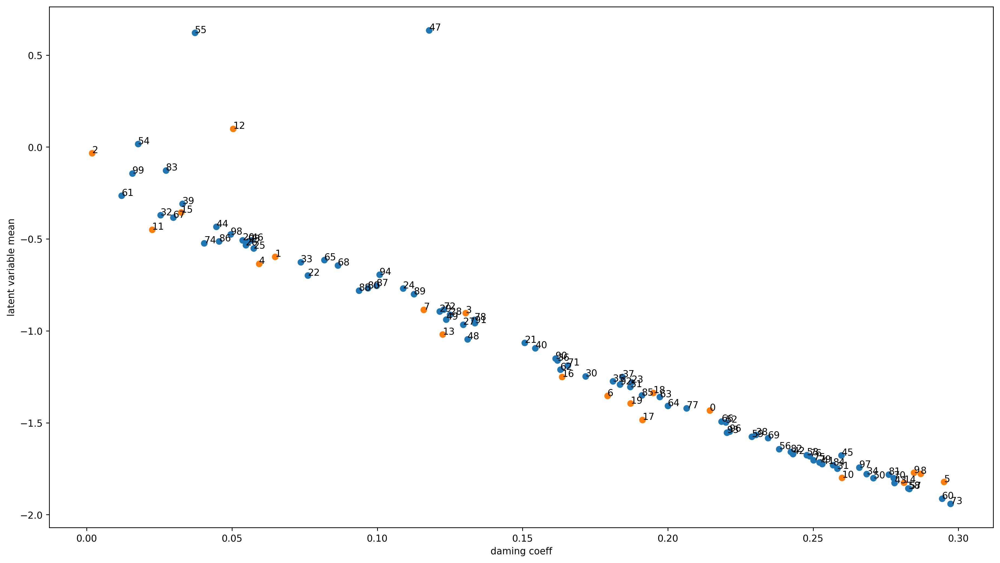

[0.2144448  0.06482685 0.00186908 0.13043746 0.05930552 0.2950202
 0.17920018 0.11597138 0.28699589 0.28469319]
[0.25988679 0.02248458 0.05039166 0.12253316 0.28127148 0.03245801
 0.1635608  0.19128307 0.19494153 0.18717483]
[0.05369217 0.15075992 0.07610389 0.18747925 0.10885608 0.05743392
 0.05473362 0.12954662 0.12503289 0.12144757]
[0.17164163 0.25830429 0.02539848 0.07363611 0.26839539 0.18106905
 0.16202242 0.18436885 0.23032741 0.03294544]
[0.15439611 0.2531121  0.24304333 0.27801621 0.04461805 0.25973247
 0.05670773 0.11783435 0.13102989 0.12374166]
[0.27072656 0.18707065 0.21989962 0.24780686 0.01766403 0.03720439
 0.238327   0.28313925 0.28277575 0.22889809]
[0.29436298 0.01202734 0.16298709 0.19724539 0.19996752 0.08174144
 0.21848083 0.02979833 0.08641105 0.23445934]
[0.27774258 0.16557793 0.12287742 0.29723905 0.04042578 0.25013441
 0.24882538 0.20646638 0.1333622  0.25213982]
[0.09677249 0.2759962  0.24226469 0.02727317 0.25685513 0.1910546
 0.04556568 0.09974855 0.093661

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.eps")
# plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_bamdppolicy_data()


 0 9.5367431640625e-07


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ


 1 3.7639942169189453

 2 3.330198049545288

 3 3.2015063762664795

 4 3.1146349906921387

 5 3.2348458766937256

 6 3.2604241371154785

 7 3.388728380203247

 8 3.0995969772338867

 9 3.182481288909912

 10 3.1932883262634277

 11 3.39302921295166

 12 3.03981614112854

 13 3.1830127239227295

 14 3.039954662322998

 15 3.0924439430236816

 16 3.073287010192871

 17 3.1219046115875244

 18 3.28118634223938

 19 3.341904640197754

 20 3.0925562381744385

 21 3.053720235824585

 22 3.0431323051452637

 23 3.1029984951019287

 24 3.181879758834839

 25 3.173264980316162

 26 3.023118734359741

 27 3.0128159523010254

 28 3.2099199295043945

 29 3.1523423194885254

 30 3.051771640777588

 31 3.051182985305786

 32 3.2581541538238525

 33 3.0226080417633057

 34 3.138317346572876

 35 3.206871271133423

 36 3.204263925552368

 37 3.0787930488586426

 38 3.1759631633758545

 39 3.324861764907837

 40 3.0996522903442383

 41 3.058168888092041

 42 3.1274237632751465

 43 3.1595354080200195


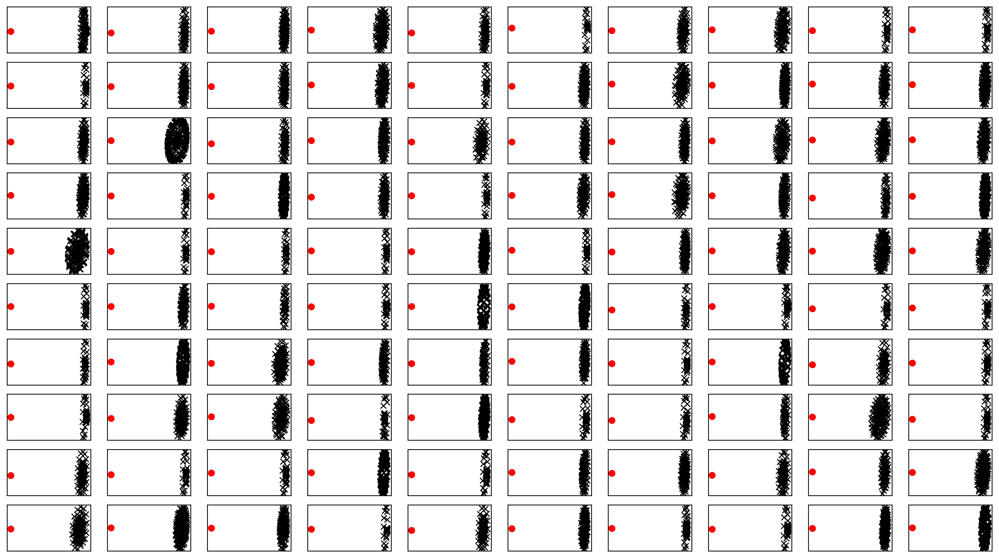

In [7]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx")
    ax_list[-1].plot(0, 0,"ro") 
plt.show()

In [8]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)

実環境方策rollout vs Sim環境方策rollout


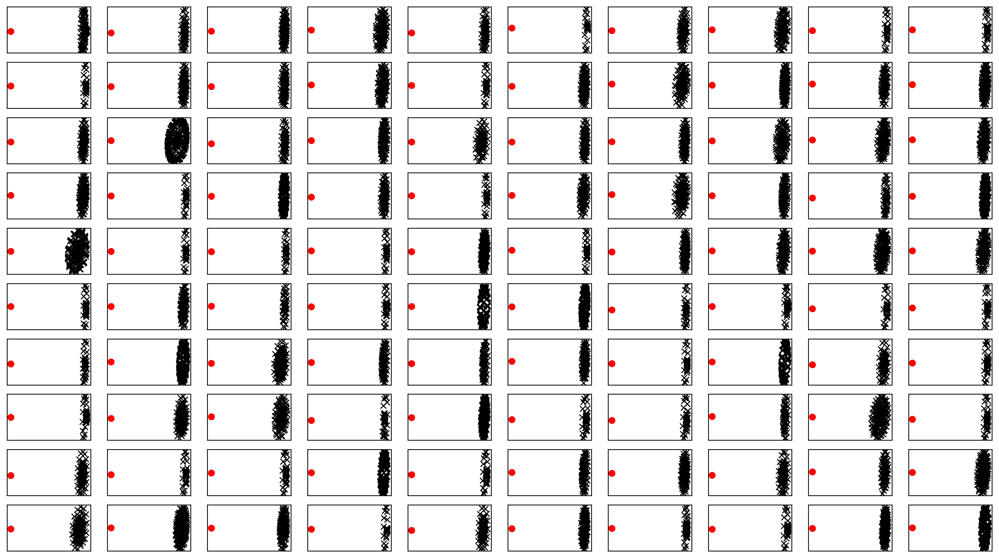

In [9]:


fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1])
    
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 

plt.savefig(figfilenamehead+"iter0.png")
# plt.savefig(figfilenamehead+"iter0.pdf")
plt.savefig(figfilenamehead+"iter0.eps")
print("実環境方策rollout vs Sim環境方策rollout")

In [10]:
print(datetime.datetime.now())

2023-06-12 14:40:39.952170


# Iter 1

In [11]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2
predict diverge [ 3.9680779  21.36870881] [1.59897905 3.68293225] [124.03733  20.     ] [62.018665 10.      ] sim_timestep 126

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [12]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.39072  validloss 1.41176±0.00000  bestvalidloss 1.41176  last_update 0
train: iter 1  trainloss 1.38542  validloss 1.38697±0.00000  bestvalidloss 1.38697  last_update 0
train: iter 2  trainloss 1.38255  validloss 1.38176±0.00000  bestvalidloss 1.38176  last_update 0
train: iter 3  trainloss 1.37921  validloss 1.37507±0.00000  bestvalidloss 1.37507  last_update 0
train: iter 4  trainloss 1.37621  validloss 1.37065±0.00000  bestvalidloss 1.37065  last_update 0
train: iter 5  trainloss 1.37377  validloss 1.36336±0.00000  bestvalidloss 1.36336  last_update 0
train: iter 6  trainloss 1.37248  validloss 1.36089±0.00000  bestvalidloss 1.36089  last_update 0
train: iter 7  trainloss 1.37140  validloss 1.35646±0.00000  bestvalidloss 1.35646  last_update 0
train: iter 8  trainloss 1.37017  validloss 1.35495±0.00000  bestvalidloss 1.35495  last_update 0
train: iter 9  trainloss 1.36918  validloss 1.35435±0.00000  bestvalidloss 1.35435  last_update 0
train: iter 10  trai

train: iter 83  trainloss 1.35300  validloss 1.34751±0.00000  bestvalidloss 1.34637  last_update 5
train: iter 84  trainloss 1.35228  validloss 1.34800±0.00000  bestvalidloss 1.34637  last_update 6
train: iter 85  trainloss 1.35233  validloss 1.34742±0.00000  bestvalidloss 1.34637  last_update 7
train: iter 86  trainloss 1.35253  validloss 1.34778±0.00000  bestvalidloss 1.34637  last_update 8
train: iter 87  trainloss 1.35237  validloss 1.34706±0.00000  bestvalidloss 1.34637  last_update 9
train: iter 88  trainloss 1.35267  validloss 1.34786±0.00000  bestvalidloss 1.34637  last_update 10
train: iter 89  trainloss 1.35199  validloss 1.34843±0.00000  bestvalidloss 1.34637  last_update 11
train: iter 90  trainloss 1.35277  validloss 1.34700±0.00000  bestvalidloss 1.34637  last_update 12
train: iter 91  trainloss 1.35333  validloss 1.34776±0.00000  bestvalidloss 1.34637  last_update 13
train: iter 92  trainloss 1.35191  validloss 1.34766±0.00000  bestvalidloss 1.34637  last_update 14
train

train: iter 165  trainloss 1.35018  validloss 1.34840±0.00000  bestvalidloss 1.34396  last_update 5
train: iter 166  trainloss 1.34951  validloss 1.34909±0.00000  bestvalidloss 1.34396  last_update 6
train: iter 167  trainloss 1.34813  validloss 1.34621±0.00000  bestvalidloss 1.34396  last_update 7
train: iter 168  trainloss 1.34821  validloss 1.34534±0.00000  bestvalidloss 1.34396  last_update 8
train: iter 169  trainloss 1.34867  validloss 1.34614±0.00000  bestvalidloss 1.34396  last_update 9
train: iter 170  trainloss 1.34814  validloss 1.34466±0.00000  bestvalidloss 1.34396  last_update 10
train: iter 171  trainloss 1.34783  validloss 1.34575±0.00000  bestvalidloss 1.34396  last_update 11
train: iter 172  trainloss 1.34920  validloss 1.34854±0.00000  bestvalidloss 1.34396  last_update 12
train: iter 173  trainloss 1.34891  validloss 1.34718±0.00000  bestvalidloss 1.34396  last_update 13
train: iter 174  trainloss 1.34830  validloss 1.34700±0.00000  bestvalidloss 1.34396  last_updat

train: iter 247  trainloss 1.34494  validloss 1.34509±0.00000  bestvalidloss 1.34337  last_update 12
train: iter 248  trainloss 1.34528  validloss 1.34449±0.00000  bestvalidloss 1.34337  last_update 13
train: iter 249  trainloss 1.34597  validloss 1.34491±0.00000  bestvalidloss 1.34337  last_update 14
train: iter 250  trainloss 1.34520  validloss 1.34381±0.00000  bestvalidloss 1.34337  last_update 15
train: iter 251  trainloss 1.34601  validloss 1.34452±0.00000  bestvalidloss 1.34337  last_update 16
train: iter 252  trainloss 1.34596  validloss 1.34522±0.00000  bestvalidloss 1.34337  last_update 17
train: iter 253  trainloss 1.34752  validloss 1.34964±0.00000  bestvalidloss 1.34337  last_update 18
train: iter 254  trainloss 1.34560  validloss 1.34439±0.00000  bestvalidloss 1.34337  last_update 19
train: iter 255  trainloss 1.34529  validloss 1.34457±0.00000  bestvalidloss 1.34337  last_update 20
train: iter 256  trainloss 1.34490  validloss 1.34680±0.00000  bestvalidloss 1.34337  last_

train: iter 329  trainloss 1.34358  validloss 1.34705±0.00000  bestvalidloss 1.34154  last_update 35
train: iter 330  trainloss 1.34372  validloss 1.34283±0.00000  bestvalidloss 1.34154  last_update 36
train: iter 331  trainloss 1.34308  validloss 1.34391±0.00000  bestvalidloss 1.34154  last_update 37
train: iter 332  trainloss 1.34346  validloss 1.34827±0.00000  bestvalidloss 1.34154  last_update 38
train: iter 333  trainloss 1.34338  validloss 1.34245±0.00000  bestvalidloss 1.34154  last_update 39
train: iter 334  trainloss 1.34413  validloss 1.34502±0.00000  bestvalidloss 1.34154  last_update 40
train: iter 335  trainloss 1.34332  validloss 1.34325±0.00000  bestvalidloss 1.34154  last_update 41
train: iter 336  trainloss 1.34247  validloss 1.34250±0.00000  bestvalidloss 1.34154  last_update 42
train: iter 337  trainloss 1.34268  validloss 1.34407±0.00000  bestvalidloss 1.34154  last_update 43
train: iter 338  trainloss 1.34363  validloss 1.34901±0.00000  bestvalidloss 1.34154  last_

train: iter 411  trainloss 1.34212  validloss 1.34313±0.00000  bestvalidloss 1.34093  last_update 23
train: iter 412  trainloss 1.34137  validloss 1.34712±0.00000  bestvalidloss 1.34093  last_update 24
train: iter 413  trainloss 1.34236  validloss 1.34871±0.00000  bestvalidloss 1.34093  last_update 25
train: iter 414  trainloss 1.34236  validloss 1.34352±0.00000  bestvalidloss 1.34093  last_update 26
train: iter 415  trainloss 1.34232  validloss 1.34472±0.00000  bestvalidloss 1.34093  last_update 27
train: iter 416  trainloss 1.34189  validloss 1.34668±0.00000  bestvalidloss 1.34093  last_update 28
train: iter 417  trainloss 1.34198  validloss 1.34829±0.00000  bestvalidloss 1.34093  last_update 29
train: iter 418  trainloss 1.34122  validloss 1.34586±0.00000  bestvalidloss 1.34093  last_update 30
train: iter 419  trainloss 1.34313  validloss 1.34384±0.00000  bestvalidloss 1.34093  last_update 31
train: iter 420  trainloss 1.34250  validloss 1.34382±0.00000  bestvalidloss 1.34093  last_

([1.3907163977622985,
  1.385420460999012,
  1.382547053694725,
  1.3792052432894706,
  1.3762123584747314,
  1.3737665683031082,
  1.3724784716963767,
  1.371402569115162,
  1.3701659560203552,
  1.369179332256317,
  1.3685981258749962,
  1.3675624281167984,
  1.3670971274375916,
  1.366245585680008,
  1.365820152312517,
  1.3652661897242069,
  1.3644216537475586,
  1.364485241472721,
  1.3635896742343903,
  1.362782720476389,
  1.3640173442661763,
  1.3621470287442208,
  1.3623560816049576,
  1.361125722527504,
  1.3618850097060204,
  1.3605711199343204,
  1.3606373265385627,
  1.3607195504009724,
  1.3601775452494622,
  1.3593740098178386,
  1.359403197467327,
  1.3593654789030551,
  1.3591055661439895,
  1.358551523834467,
  1.3589940287172795,
  1.3583311341702937,
  1.3579211689531803,
  1.3579342618584633,
  1.3582099750638008,
  1.357516995072365,
  1.3578203424811364,
  1.3573609098792077,
  1.356818649917841,
  1.3573784045875072,
  1.356319859623909,
  1.3562873147428036,
  

In [13]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -5.110432974338532
valid_loss:  -5.124499996948241
weight_alpha 1.0 h_min_tilde -6.162117 ell_tilde -5.113246378860474 kappa_tilde 0.0009764253331993783
train_loss:  -5.339952536273003
valid_loss:  -5.110695264053344
weight_alpha 0.1 h_min_tilde -6.162117 ell_tilde -5.294101081829072 kappa_tilde 0.0010733371322661101


1e-08 1000.0


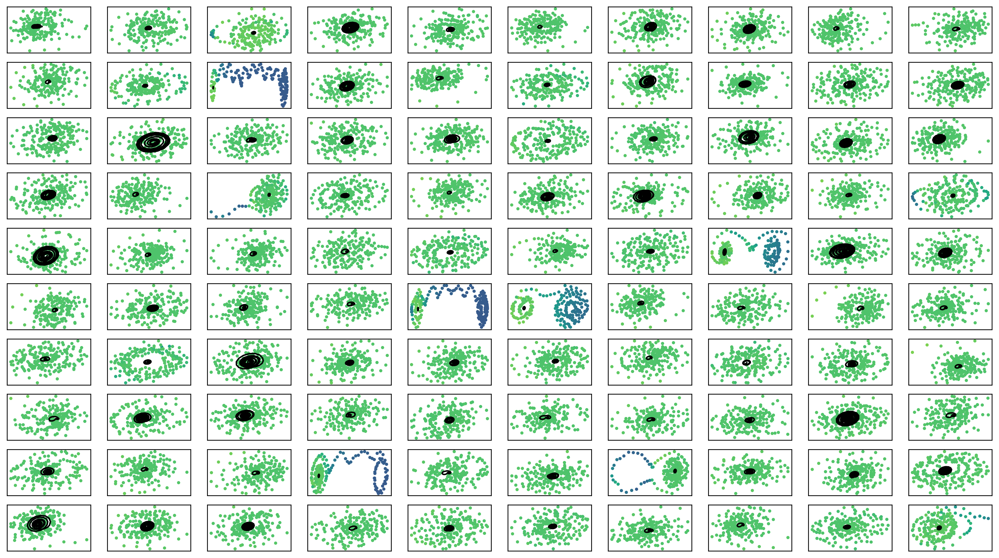

In [14]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [15]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=default_early, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=default_early, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -1041.35909  validloss -1025.57527±0.00000  bestvalidloss -1025.57527  last_update 0
train: iter 1  trainloss -1055.14658  validloss -952.94529±0.00000  bestvalidloss -1025.57527  last_update 1
train: iter 2  trainloss -1040.63117  validloss -1009.72481±0.00000  bestvalidloss -1025.57527  last_update 2
train: iter 3  trainloss -965.86709  validloss -919.42020±0.00000  bestvalidloss -1025.57527  last_update 3
train: iter 4  trainloss -1042.83245  validloss -976.31555±0.00000  bestvalidloss -1025.57527  last_update 4
train: iter 5  trainloss -1034.30261  validloss -929.09728±0.00000  bestvalidloss -1025.57527  last_update 5
train: iter 6  trainloss -1062.15193  validloss -1024.50853±0.00000  bestvalidloss -1025.57527  last_update 6
train: iter 7  trainloss -1067.63735  validloss -907.12724±0.00000  bestvalidloss -1025.57527  last_update 7
train: iter 8  trainloss -1069.53929  validloss -1005.41512±0.00000  bestvalidlos

train: iter 74  trainloss -1049.69119  validloss -1026.52006±0.00000  bestvalidloss -1026.52006  last_update 0
train: iter 75  trainloss -1071.26318  validloss -1005.58169±0.00000  bestvalidloss -1026.52006  last_update 1
train: iter 76  trainloss -1080.31386  validloss -1001.83812±0.00000  bestvalidloss -1026.52006  last_update 2
train: iter 77  trainloss -1077.71984  validloss -991.91560±0.00000  bestvalidloss -1026.52006  last_update 3
train: iter 78  trainloss -1060.49393  validloss -1013.84507±0.00000  bestvalidloss -1026.52006  last_update 4
train: iter 79  trainloss -1075.51268  validloss -983.63862±0.00000  bestvalidloss -1026.52006  last_update 5
train: iter 80  trainloss -1058.00477  validloss -952.53601±0.00000  bestvalidloss -1026.52006  last_update 6
train: iter 81  trainloss -1078.08077  validloss -1020.78105±0.00000  bestvalidloss -1026.52006  last_update 7
train: iter 82  trainloss -1069.80834  validloss -950.33063±0.00000  bestvalidloss -1026.52006  last_update 8
train

train: iter 148  trainloss -1079.70779  validloss -943.00582±0.00000  bestvalidloss -1028.57802  last_update 7
train: iter 149  trainloss -1066.98939  validloss -976.43882±0.00000  bestvalidloss -1028.57802  last_update 8
train: iter 150  trainloss -1077.38028  validloss -1018.26136±0.00000  bestvalidloss -1028.57802  last_update 9
train: iter 151  trainloss -1085.96780  validloss -994.51699±0.00000  bestvalidloss -1028.57802  last_update 10
train: iter 152  trainloss -1081.47514  validloss -1021.21625±0.00000  bestvalidloss -1028.57802  last_update 11
train: iter 153  trainloss -1065.87823  validloss -890.75920±0.00000  bestvalidloss -1028.57802  last_update 12
train: iter 154  trainloss -1068.70027  validloss -1014.98634±0.00000  bestvalidloss -1028.57802  last_update 13
train: iter 155  trainloss -1048.05317  validloss -964.57591±0.00000  bestvalidloss -1028.57802  last_update 14
train: iter 156  trainloss -1062.13701  validloss -935.02690±0.00000  bestvalidloss -1028.57802  last_up

train: iter 222  trainloss -1087.75944  validloss -1022.72823±0.00000  bestvalidloss -1028.86941  last_update 21
train: iter 223  trainloss -1088.21211  validloss -963.75511±0.00000  bestvalidloss -1028.86941  last_update 22
train: iter 224  trainloss -1052.18530  validloss -1002.83396±0.00000  bestvalidloss -1028.86941  last_update 23
train: iter 225  trainloss -1041.80483  validloss -888.60473±0.00000  bestvalidloss -1028.86941  last_update 24
train: iter 226  trainloss -1070.09499  validloss -958.55749±0.00000  bestvalidloss -1028.86941  last_update 25
train: iter 227  trainloss -1083.19342  validloss -941.85199±0.00000  bestvalidloss -1028.86941  last_update 26
train: iter 228  trainloss -1083.83904  validloss -992.05763±0.00000  bestvalidloss -1028.86941  last_update 27
train: iter 229  trainloss -1093.99624  validloss -1031.02325±0.00000  bestvalidloss -1031.02325  last_update 0
train: iter 230  trainloss -1091.23236  validloss -1021.13525±0.00000  bestvalidloss -1031.02325  last

train: iter 297  trainloss -1083.07298  validloss -972.68959±0.00000  bestvalidloss -1042.06033  last_update 32
train: iter 298  trainloss -1090.78844  validloss -1026.27059±0.00000  bestvalidloss -1042.06033  last_update 33
train: iter 299  trainloss -1094.08329  validloss -1030.54165±0.00000  bestvalidloss -1042.06033  last_update 34
train: iter 300  trainloss -1102.80051  validloss -1023.86090±0.00000  bestvalidloss -1042.06033  last_update 35
train: iter 301  trainloss -1103.06351  validloss -1001.90700±0.00000  bestvalidloss -1042.06033  last_update 36
train: iter 302  trainloss -1095.42425  validloss -1008.75645±0.00000  bestvalidloss -1042.06033  last_update 37
train: iter 303  trainloss -1086.21499  validloss -1003.21495±0.00000  bestvalidloss -1042.06033  last_update 38
train: iter 304  trainloss -1074.86960  validloss -988.73949±0.00000  bestvalidloss -1042.06033  last_update 39
train: iter 305  trainloss -1072.57858  validloss -1018.23386±0.00000  bestvalidloss -1042.06033  

train: iter 370  trainloss -1090.29353  validloss -1015.81561±0.00000  bestvalidloss -1052.16455  last_update 10
train: iter 371  trainloss -1095.58062  validloss -1028.32954±0.00000  bestvalidloss -1052.16455  last_update 11
train: iter 372  trainloss -1103.01065  validloss -1001.00743±0.00000  bestvalidloss -1052.16455  last_update 12
train: iter 373  trainloss -1048.79167  validloss -1003.37825±0.00000  bestvalidloss -1052.16455  last_update 13
train: iter 374  trainloss -1090.87293  validloss -981.84072±0.00000  bestvalidloss -1052.16455  last_update 14
train: iter 375  trainloss -1096.83722  validloss -1033.89831±0.00000  bestvalidloss -1052.16455  last_update 15
train: iter 376  trainloss -1094.81851  validloss -1032.80583±0.00000  bestvalidloss -1052.16455  last_update 16
train: iter 377  trainloss -1102.16638  validloss -1038.37742±0.00000  bestvalidloss -1052.16455  last_update 17
train: iter 378  trainloss -1104.07022  validloss -1035.58939±0.00000  bestvalidloss -1052.16455 

train: iter 443  trainloss -1097.47135  validloss -939.78192±0.00000  bestvalidloss -1052.16455  last_update 83
train: iter 444  trainloss -1090.27314  validloss -991.66012±0.00000  bestvalidloss -1052.16455  last_update 84
train: iter 445  trainloss -1100.22948  validloss -970.61589±0.00000  bestvalidloss -1052.16455  last_update 85
train: iter 446  trainloss -1093.80357  validloss -999.74554±0.00000  bestvalidloss -1052.16455  last_update 86
train: iter 447  trainloss -1107.63841  validloss -981.10445±0.00000  bestvalidloss -1052.16455  last_update 87
train: iter 448  trainloss -1110.77118  validloss -1003.95146±0.00000  bestvalidloss -1052.16455  last_update 88
train: iter 449  trainloss -1081.51339  validloss -1029.89423±0.00000  bestvalidloss -1052.16455  last_update 89
train: iter 450  trainloss -1066.54308  validloss -970.45353±0.00000  bestvalidloss -1052.16455  last_update 90
train: iter 451  trainloss -1043.34079  validloss -1029.12441±0.00000  bestvalidloss -1052.16455  last

train: iter 516  trainloss -1072.50202  validloss -877.93595±0.00000  bestvalidloss -1052.20295  last_update 62
train: iter 517  trainloss -1103.99680  validloss -980.55005±0.00000  bestvalidloss -1052.20295  last_update 63
train: iter 518  trainloss -1113.27008  validloss -1019.80630±0.00000  bestvalidloss -1052.20295  last_update 64
train: iter 519  trainloss -1113.90510  validloss -1014.66454±0.00000  bestvalidloss -1052.20295  last_update 65
train: iter 520  trainloss -1115.01730  validloss -1028.87435±0.00000  bestvalidloss -1052.20295  last_update 66
train: iter 521  trainloss -1107.38406  validloss -1020.27249±0.00000  bestvalidloss -1052.20295  last_update 67
train: iter 522  trainloss -1106.49245  validloss -1042.41395±0.00000  bestvalidloss -1052.20295  last_update 68
train: iter 523  trainloss -1112.20009  validloss -1005.94848±0.00000  bestvalidloss -1052.20295  last_update 69
train: iter 524  trainloss -1112.83226  validloss -1007.98929±0.00000  bestvalidloss -1052.20295  

train: iter 589  trainloss -1101.59971  validloss -1024.79030±0.00000  bestvalidloss -1054.77705  last_update 59
train: iter 590  trainloss -1106.69840  validloss -1042.52796±0.00000  bestvalidloss -1054.77705  last_update 60
train: iter 591  trainloss -1088.75327  validloss -1050.33601±0.00000  bestvalidloss -1054.77705  last_update 61
train: iter 592  trainloss -1112.05742  validloss -998.44130±0.00000  bestvalidloss -1054.77705  last_update 62
train: iter 593  trainloss -1101.42129  validloss -1030.53693±0.00000  bestvalidloss -1054.77705  last_update 63
train: iter 594  trainloss -1088.66137  validloss -1037.92418±0.00000  bestvalidloss -1054.77705  last_update 64
train: iter 595  trainloss -1093.27781  validloss -969.96462±0.00000  bestvalidloss -1054.77705  last_update 65
train: iter 596  trainloss -1102.83738  validloss -1048.39741±0.00000  bestvalidloss -1054.77705  last_update 66
train: iter 597  trainloss -1075.88590  validloss -969.58320±0.00000  bestvalidloss -1054.77705  l

train: iter 662  trainloss -1122.76161  validloss -1029.25565±0.00000  bestvalidloss -1059.60642  last_update 58
train: iter 663  trainloss -1121.58927  validloss -927.89769±0.00000  bestvalidloss -1059.60642  last_update 59
train: iter 664  trainloss -1119.05708  validloss -1036.85734±0.00000  bestvalidloss -1059.60642  last_update 60
train: iter 665  trainloss -1121.00244  validloss -1000.01119±0.00000  bestvalidloss -1059.60642  last_update 61
train: iter 666  trainloss -1089.65432  validloss -1001.68580±0.00000  bestvalidloss -1059.60642  last_update 62
train: iter 667  trainloss -1079.59750  validloss -981.21967±0.00000  bestvalidloss -1059.60642  last_update 63
train: iter 668  trainloss -1088.26229  validloss -714.58143±0.00000  bestvalidloss -1059.60642  last_update 64
train: iter 669  trainloss -1011.16868  validloss -1011.55959±0.00000  bestvalidloss -1059.60642  last_update 65
train: iter 670  trainloss -1101.26091  validloss -993.02457±0.00000  bestvalidloss -1059.60642  la

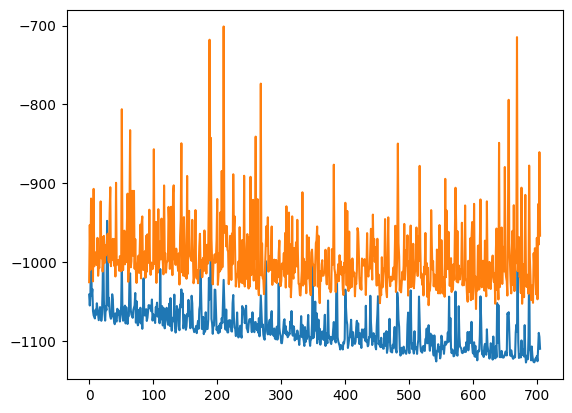

alpha 0.1 default_lr 0.0005


In [16]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

In [17]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)



実環境方策rollout vs Sim環境方策rollout


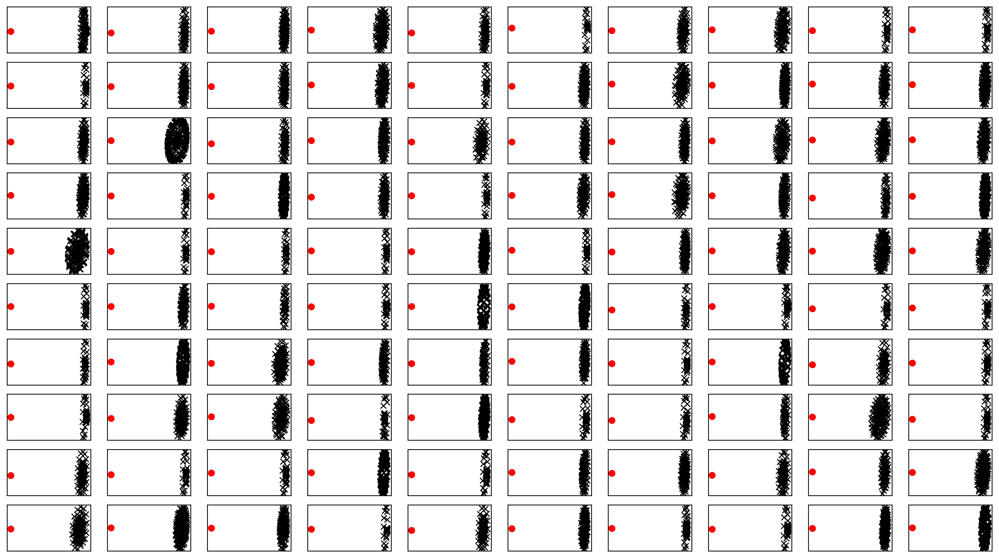

In [18]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro")     
plt.savefig(figfilenamehead+"iter1.png")
plt.savefig(figfilenamehead+"iter1.eps")
# plt.savefig(figfilenamehead+"iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

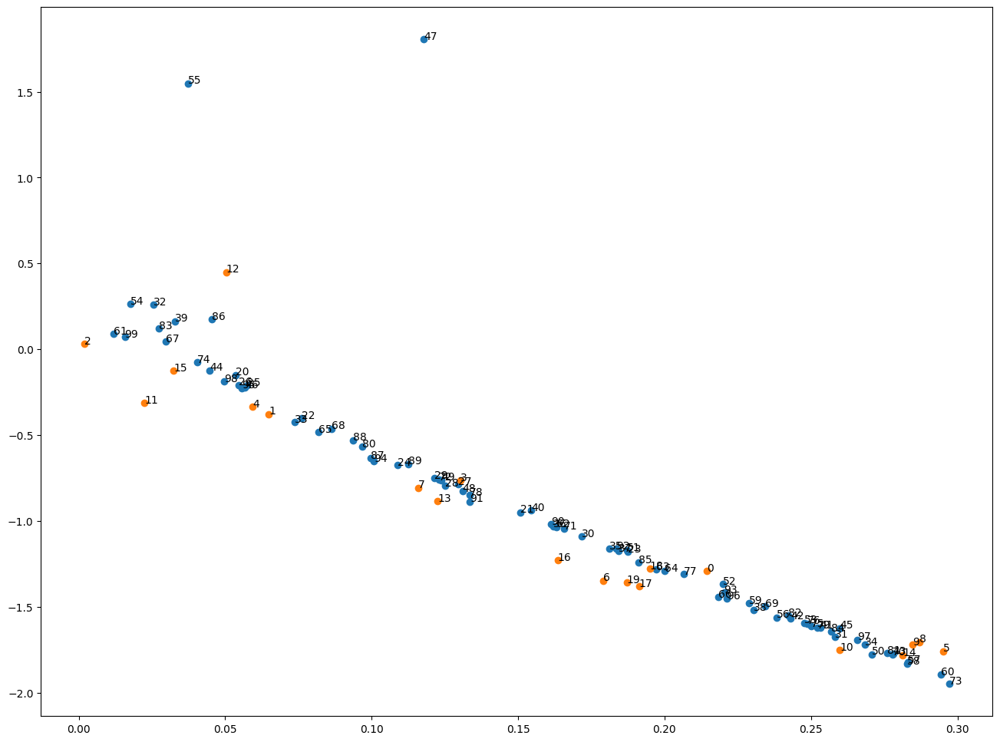

[0.2144448  0.06482685 0.00186908 0.13043746 0.05930552 0.2950202
 0.17920018 0.11597138 0.28699589 0.28469319]
[0.25988679 0.02248458 0.05039166 0.12253316 0.28127148 0.03245801
 0.1635608  0.19128307 0.19494153 0.18717483]
[0.05369217 0.15075992 0.07610389 0.18747925 0.10885608 0.05743392
 0.05473362 0.12954662 0.12503289 0.12144757]
[0.17164163 0.25830429 0.02539848 0.07363611 0.26839539 0.18106905
 0.16202242 0.18436885 0.23032741 0.03294544]
[0.15439611 0.2531121  0.24304333 0.27801621 0.04461805 0.25973247
 0.05670773 0.11783435 0.13102989 0.12374166]
[0.27072656 0.18707065 0.21989962 0.24780686 0.01766403 0.03720439
 0.238327   0.28313925 0.28277575 0.22889809]
[0.29436298 0.01202734 0.16298709 0.19724539 0.19996752 0.08174144
 0.21848083 0.02979833 0.08641105 0.23445934]
[0.27774258 0.16557793 0.12287742 0.29723905 0.04042578 0.25013441
 0.24882538 0.20646638 0.1333622  0.25213982]
[0.09677249 0.2759962  0.24226469 0.02727317 0.25685513 0.1910546
 0.04556568 0.09974855 0.093661

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-06-12 15:01:37.785430


# Iter2

In [21]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.55626  validloss 1.37208±0.00000  bestvalidloss 1.37208  last_update 0
train: iter 1  trainloss 1.45381  validloss 1.34231±0.00000  bestvalidloss 1.34231  last_update 0
train: iter 2  trainloss 1.39208  validloss 1.33444±0.00000  bestvalidloss 1.33444  last_update 0
train: iter 3  trainloss 1.37242  validloss 1.33079±0.00000  bestvalidloss 1.33079  last_update 0
train: iter 4  trainloss 1.36236  validloss 1.33097±0.00000  bestvalidloss 1.33079  last_update 1
train: iter 5  trainloss 1.35728  validloss 1.33036±0.00000  bestvalidloss 1.33036  last_update 0
train: iter 6  trainloss 1.35359  validloss 1.33059±0.00000  bestvalidloss 1.33036  last_update 1
train: iter 7  trainloss 1.35115  validloss 1.32780±0.00000  bestvalidloss 1.32780  last_update 0
train: iter 8  trainloss 1.34951  validloss 1.32850±0.00000  bestvalidloss 1.32780  last_update 1
train: iter 9  trainloss 1.34820  validloss 1.32670±0.00000  bestvalidloss 1.32670  last_update 0
train: iter 10  trai

train: iter 83  trainloss 1.32870  validloss 1.33874±0.00000  bestvalidloss 1.32670  last_update 74
train: iter 84  trainloss 1.32822  validloss 1.34718±0.00000  bestvalidloss 1.32670  last_update 75
train: iter 85  trainloss 1.32803  validloss 1.34109±0.00000  bestvalidloss 1.32670  last_update 76
train: iter 86  trainloss 1.32724  validloss 1.34639±0.00000  bestvalidloss 1.32670  last_update 77
train: iter 87  trainloss 1.32850  validloss 1.35272±0.00000  bestvalidloss 1.32670  last_update 78
train: iter 88  trainloss 1.32711  validloss 1.35244±0.00000  bestvalidloss 1.32670  last_update 79
train: iter 89  trainloss 1.32624  validloss 1.35514±0.00000  bestvalidloss 1.32670  last_update 80
train: iter 90  trainloss 1.32632  validloss 1.35029±0.00000  bestvalidloss 1.32670  last_update 81
train: iter 91  trainloss 1.32644  validloss 1.35400±0.00000  bestvalidloss 1.32670  last_update 82
train: iter 92  trainloss 1.32608  validloss 1.34787±0.00000  bestvalidloss 1.32670  last_update 83


([1.5562619797885417,
  1.4538131549954414,
  1.392079909145832,
  1.3724228277802468,
  1.3623638883233071,
  1.3572848998010159,
  1.3535922035574912,
  1.3511500157415868,
  1.3495131984353066,
  1.3481958605349065,
  1.346555471420288,
  1.345988081395626,
  1.344937525689602,
  1.344661846011877,
  1.3436866894364357,
  1.3428779527544976,
  1.3428650334477426,
  1.3418690495193004,
  1.3422266654670238,
  1.3414102911949157,
  1.3410421930253507,
  1.340605129301548,
  1.3405941016972065,
  1.3396130315959454,
  1.3395804643630982,
  1.339149897545576,
  1.3388450302183628,
  1.3388032250106334,
  1.3383231200277805,
  1.3376745343208314,
  1.3379409439861774,
  1.3371086701750756,
  1.337805686891079,
  1.3368696212768554,
  1.3369995318353176,
  1.3365778878331185,
  1.3359931379556655,
  1.3357545234262944,
  1.3352527983486653,
  1.3355187758803369,
  1.335465271025896,
  1.3344358570873738,
  1.3350009068846702,
  1.3341568008065223,
  1.3342800334095954,
  1.334088823199272

In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -5.598135400867461
valid_loss:  -5.129691903686522
weight_alpha 1.0 h_min_tilde -6.162122 ell_tilde -5.504446701431274 kappa_tilde 0.0012330886767380647
train_loss:  -5.442119079685211
valid_loss:  -5.051035572433472
weight_alpha 0.1 h_min_tilde -6.162122 ell_tilde -5.363902378234863 kappa_tilde 0.0011192803055314238


1e-08 1000.0


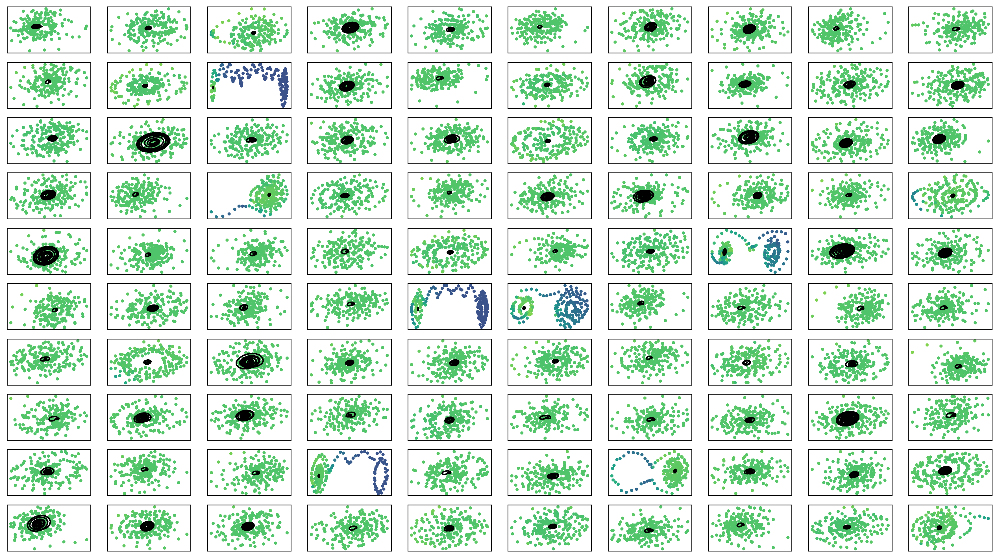

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -1089.55974  validloss -1005.56563±0.00000  bestvalidloss -1005.56563  last_update 0
train: iter 1  trainloss -1119.06974  validloss -1006.79661±0.00000  bestvalidloss -1006.79661  last_update 0
train: iter 2  trainloss -1117.50786  validloss -1020.63080±0.00000  bestvalidloss -1020.63080  last_update 0
train: iter 3  trainloss -1108.27966  validloss -1033.30370±0.00000  bestvalidloss -1033.30370  last_update 0
train: iter 4  trainloss -1105.54174  validloss -1031.25264±0.00000  bestvalidloss -1033.30370  last_update 1
train: iter 5  trainloss -1116.08327  validloss -1037.30856±0.00000  bestvalidloss -1037.30856  last_update 0
train: iter 6  trainloss -1106.79345  validloss -1013.55977±0.00000  bestvalidloss -1037.30856  last_update 1
train: iter 7  trainloss -1095.76299  validloss -1032.93930±0.00000  bestvalidloss -1037.30856  last_update 2
train: iter 8  trainloss -1094.08210  validloss -834.92032±0.00000  bestval

train: iter 74  trainloss -1122.86290  validloss -1049.61730±0.00000  bestvalidloss -1049.61730  last_update 0
train: iter 75  trainloss -1114.05194  validloss -954.24243±0.00000  bestvalidloss -1049.61730  last_update 1
train: iter 76  trainloss -1077.11071  validloss -1051.71156±0.00000  bestvalidloss -1051.71156  last_update 0
train: iter 77  trainloss -1101.09685  validloss -1007.46426±0.00000  bestvalidloss -1051.71156  last_update 1
train: iter 78  trainloss -1121.76431  validloss -1025.26757±0.00000  bestvalidloss -1051.71156  last_update 2
train: iter 79  trainloss -1121.82488  validloss -1035.92591±0.00000  bestvalidloss -1051.71156  last_update 3
train: iter 80  trainloss -1082.07557  validloss -1045.32920±0.00000  bestvalidloss -1051.71156  last_update 4
train: iter 81  trainloss -1094.58667  validloss -988.45005±0.00000  bestvalidloss -1051.71156  last_update 5
train: iter 82  trainloss -1100.69203  validloss -1004.06084±0.00000  bestvalidloss -1051.71156  last_update 6
tra

train: iter 148  trainloss -1104.43714  validloss -994.55427±0.00000  bestvalidloss -1054.48717  last_update 62
train: iter 149  trainloss -1098.23451  validloss -1016.17540±0.00000  bestvalidloss -1054.48717  last_update 63
train: iter 150  trainloss -1119.01664  validloss -927.81804±0.00000  bestvalidloss -1054.48717  last_update 64
train: iter 151  trainloss -1115.11313  validloss -1035.91984±0.00000  bestvalidloss -1054.48717  last_update 65
train: iter 152  trainloss -1105.61846  validloss -1022.29332±0.00000  bestvalidloss -1054.48717  last_update 66
train: iter 153  trainloss -1106.60426  validloss -1020.74722±0.00000  bestvalidloss -1054.48717  last_update 67
train: iter 154  trainloss -1113.02034  validloss -1007.50939±0.00000  bestvalidloss -1054.48717  last_update 68
train: iter 155  trainloss -1103.52615  validloss -981.88405±0.00000  bestvalidloss -1054.48717  last_update 69
train: iter 156  trainloss -1123.69229  validloss -1026.50483±0.00000  bestvalidloss -1054.48717  l

train: iter 221  trainloss -1126.56906  validloss -1014.46648±0.00000  bestvalidloss -1065.01985  last_update 1
train: iter 222  trainloss -1125.23555  validloss -1022.45777±0.00000  bestvalidloss -1065.01985  last_update 2
train: iter 223  trainloss -1125.35531  validloss -1037.17361±0.00000  bestvalidloss -1065.01985  last_update 3
train: iter 224  trainloss -1127.45018  validloss -1026.25847±0.00000  bestvalidloss -1065.01985  last_update 4
train: iter 225  trainloss -1124.47538  validloss -961.31176±0.00000  bestvalidloss -1065.01985  last_update 5
train: iter 226  trainloss -1097.33663  validloss -1019.54390±0.00000  bestvalidloss -1065.01985  last_update 6
train: iter 227  trainloss -1017.88421  validloss -794.81337±0.00000  bestvalidloss -1065.01985  last_update 7
train: iter 228  trainloss -1120.54066  validloss -1018.71539±0.00000  bestvalidloss -1065.01985  last_update 8
train: iter 229  trainloss -1125.70090  validloss -1009.58490±0.00000  bestvalidloss -1065.01985  last_upd

train: iter 294  trainloss -1082.54760  validloss -1048.87381±0.00000  bestvalidloss -1065.01985  last_update 74
train: iter 295  trainloss -1105.29450  validloss -1036.33710±0.00000  bestvalidloss -1065.01985  last_update 75
train: iter 296  trainloss -1110.80907  validloss -963.10954±0.00000  bestvalidloss -1065.01985  last_update 76
train: iter 297  trainloss -1113.53112  validloss -942.40203±0.00000  bestvalidloss -1065.01985  last_update 77
train: iter 298  trainloss -1091.68260  validloss -1031.59285±0.00000  bestvalidloss -1065.01985  last_update 78
train: iter 299  trainloss -1116.45686  validloss -976.93425±0.00000  bestvalidloss -1065.01985  last_update 79
train: iter 300  trainloss -1125.65436  validloss -1035.83027±0.00000  bestvalidloss -1065.01985  last_update 80
train: iter 301  trainloss -1113.18128  validloss -973.35537±0.00000  bestvalidloss -1065.01985  last_update 81
train: iter 302  trainloss -1083.05439  validloss -1045.32310±0.00000  bestvalidloss -1065.01985  la

train: iter 367  trainloss -1130.24830  validloss -1014.42538±0.00000  bestvalidloss -1070.51561  last_update 58
train: iter 368  trainloss -1123.63928  validloss -1052.64605±0.00000  bestvalidloss -1070.51561  last_update 59
train: iter 369  trainloss -1121.17560  validloss -964.02464±0.00000  bestvalidloss -1070.51561  last_update 60
train: iter 370  trainloss -1119.84206  validloss -967.01475±0.00000  bestvalidloss -1070.51561  last_update 61
train: iter 371  trainloss -1122.22662  validloss -1017.68625±0.00000  bestvalidloss -1070.51561  last_update 62
train: iter 372  trainloss -1127.70600  validloss -1024.90957±0.00000  bestvalidloss -1070.51561  last_update 63
train: iter 373  trainloss -1129.44214  validloss -1038.22288±0.00000  bestvalidloss -1070.51561  last_update 64
train: iter 374  trainloss -1128.01624  validloss -1040.43062±0.00000  bestvalidloss -1070.51561  last_update 65
train: iter 375  trainloss -1121.78317  validloss -988.44325±0.00000  bestvalidloss -1070.51561  l

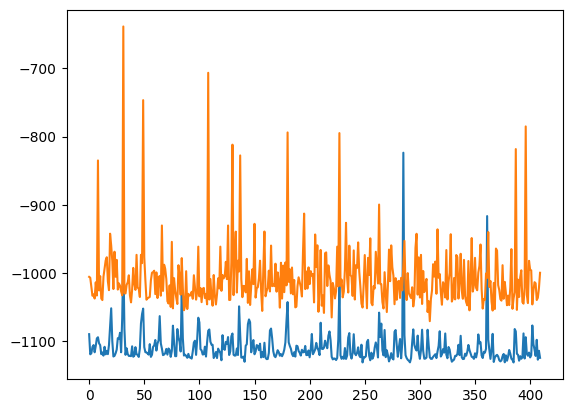

alpha 0.1 default_lr 0.0005


In [26]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

In [27]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)


実環境方策rollout vs Sim環境方策rollout


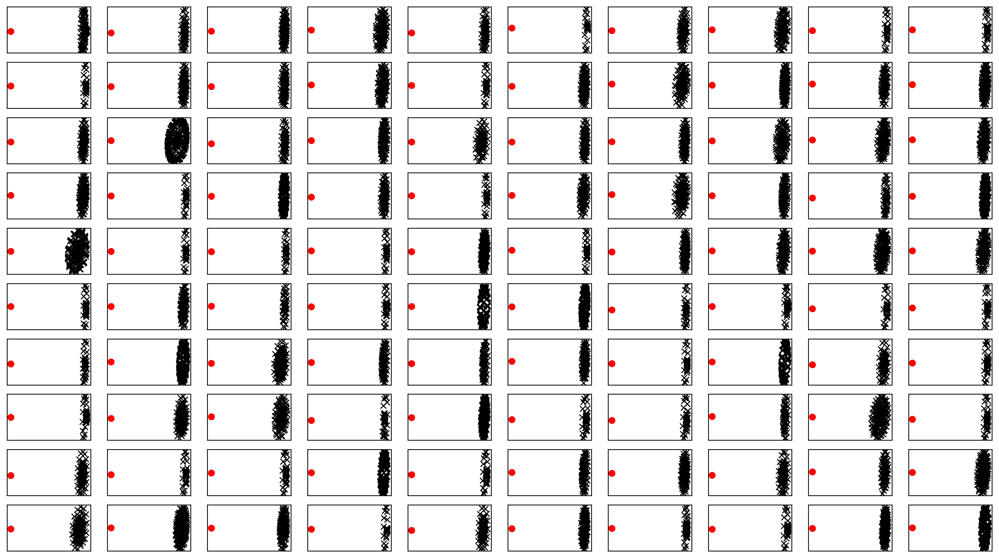

In [28]:

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro")     
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
# plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

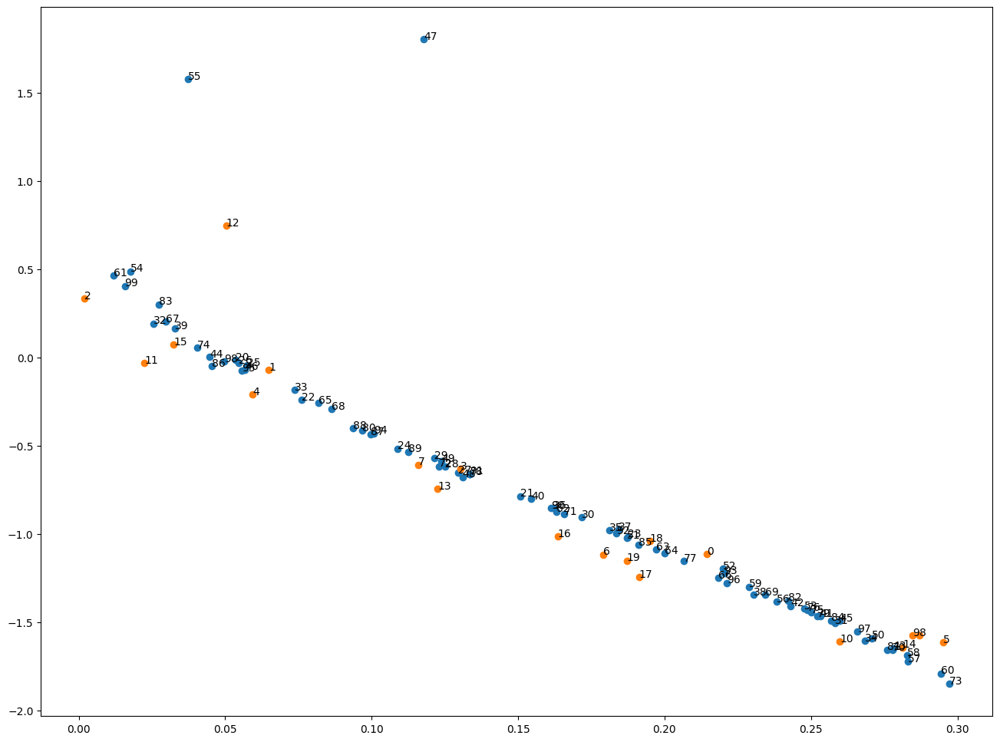

[0.2144448  0.06482685 0.00186908 0.13043746 0.05930552 0.2950202
 0.17920018 0.11597138 0.28699589 0.28469319]
[0.25988679 0.02248458 0.05039166 0.12253316 0.28127148 0.03245801
 0.1635608  0.19128307 0.19494153 0.18717483]
[0.05369217 0.15075992 0.07610389 0.18747925 0.10885608 0.05743392
 0.05473362 0.12954662 0.12503289 0.12144757]
[0.17164163 0.25830429 0.02539848 0.07363611 0.26839539 0.18106905
 0.16202242 0.18436885 0.23032741 0.03294544]
[0.15439611 0.2531121  0.24304333 0.27801621 0.04461805 0.25973247
 0.05670773 0.11783435 0.13102989 0.12374166]
[0.27072656 0.18707065 0.21989962 0.24780686 0.01766403 0.03720439
 0.238327   0.28313925 0.28277575 0.22889809]
[0.29436298 0.01202734 0.16298709 0.19724539 0.19996752 0.08174144
 0.21848083 0.02979833 0.08641105 0.23445934]
[0.27774258 0.16557793 0.12287742 0.29723905 0.04042578 0.25013441
 0.24882538 0.20646638 0.1333622  0.25213982]
[0.09677249 0.2759962  0.24226469 0.02727317 0.25685513 0.1910546
 0.04556568 0.09974855 0.093661

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-06-12 15:19:59.723055


Text(0, 0.5, 'loss')

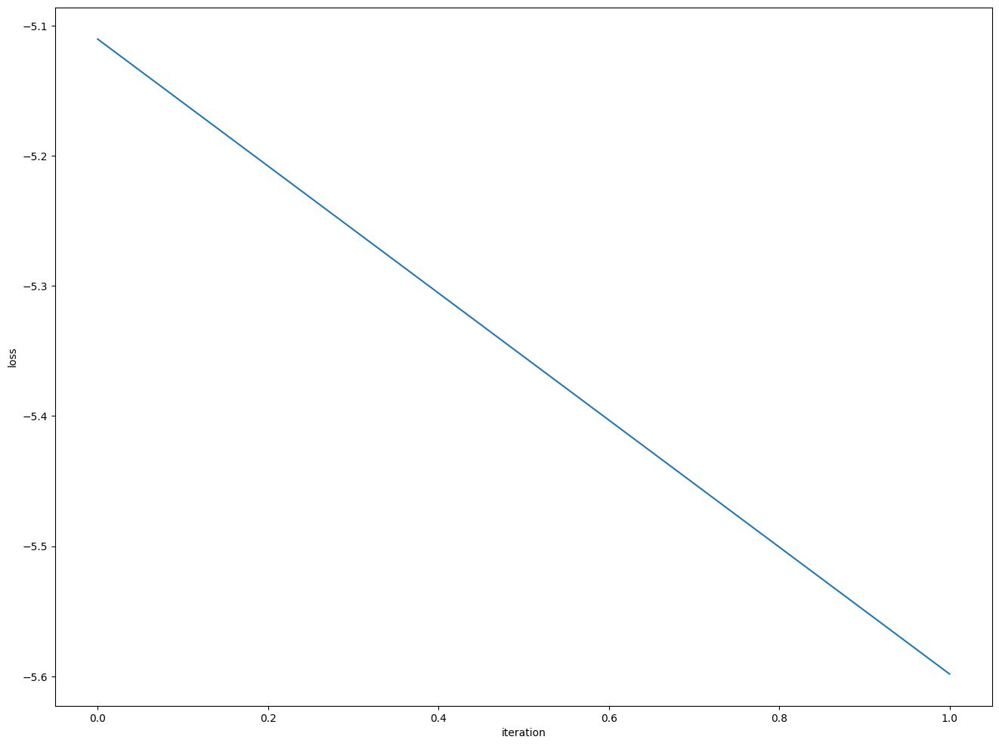

In [31]:
loss_array = np.array(loss_list)
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")


Text(0, 0.5, 'loss')

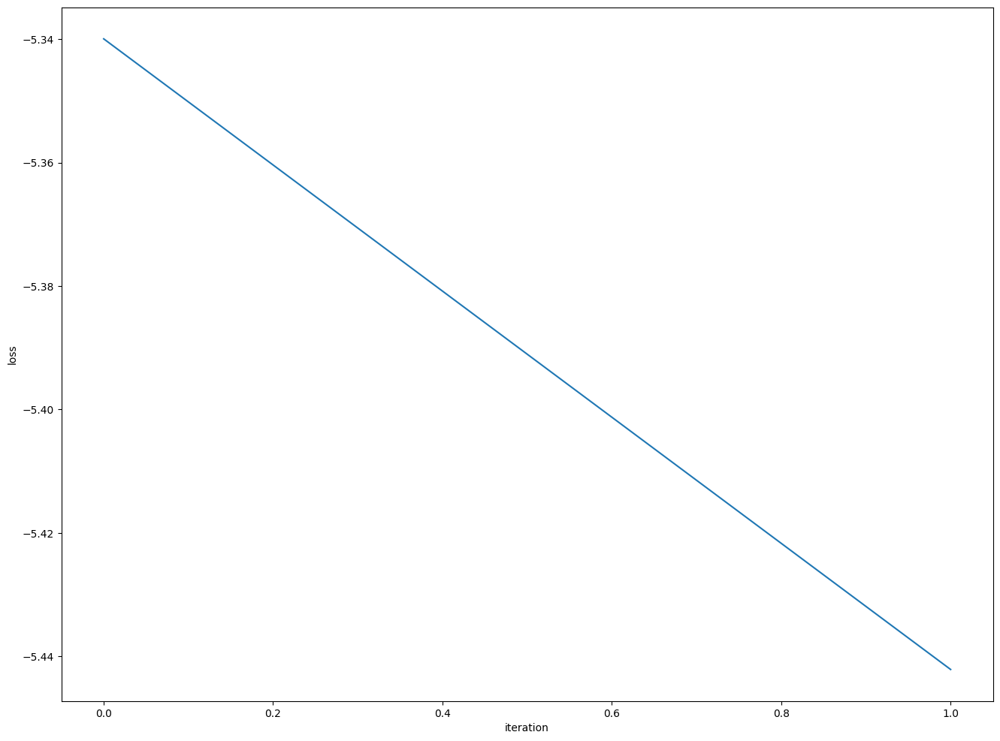

In [32]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")


# Iter 3

In [33]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [34]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.33466  validloss 1.34380±0.00000  bestvalidloss 1.34380  last_update 0
train: iter 1  trainloss 1.33270  validloss 1.34596±0.00000  bestvalidloss 1.34380  last_update 1
train: iter 2  trainloss 1.33122  validloss 1.34397±0.00000  bestvalidloss 1.34380  last_update 2
train: iter 3  trainloss 1.33011  validloss 1.35751±0.00000  bestvalidloss 1.34380  last_update 3
train: iter 4  trainloss 1.33097  validloss 1.35994±0.00000  bestvalidloss 1.34380  last_update 4
train: iter 5  trainloss 1.33062  validloss 1.35243±0.00000  bestvalidloss 1.34380  last_update 5
train: iter 6  trainloss 1.32951  validloss 1.36415±0.00000  bestvalidloss 1.34380  last_update 6
train: iter 7  trainloss 1.32929  validloss 1.35588±0.00000  bestvalidloss 1.34380  last_update 7
train: iter 8  trainloss 1.33017  validloss 1.37298±0.00000  bestvalidloss 1.34380  last_update 8
train: iter 9  trainloss 1.32905  validloss 1.35449±0.00000  bestvalidloss 1.34380  last_update 9
train: iter 10  trai

train: iter 84  trainloss 1.32199  validloss 1.38648±0.00000  bestvalidloss 1.34380  last_update 84
train: iter 85  trainloss 1.32173  validloss 1.39984±0.00000  bestvalidloss 1.34380  last_update 85
train: iter 86  trainloss 1.32178  validloss 1.42415±0.00000  bestvalidloss 1.34380  last_update 86
train: iter 87  trainloss 1.32165  validloss 1.38287±0.00000  bestvalidloss 1.34380  last_update 87
train: iter 88  trainloss 1.31950  validloss 1.38118±0.00000  bestvalidloss 1.34380  last_update 88
train: iter 89  trainloss 1.31989  validloss 1.43297±0.00000  bestvalidloss 1.34380  last_update 89
train: iter 90  trainloss 1.32153  validloss 1.38023±0.00000  bestvalidloss 1.34380  last_update 90
train: iter 91  trainloss 1.32157  validloss 1.39352±0.00000  bestvalidloss 1.34380  last_update 91
train: iter 92  trainloss 1.32104  validloss 1.41220±0.00000  bestvalidloss 1.34380  last_update 92
train: iter 93  trainloss 1.32083  validloss 1.42181±0.00000  bestvalidloss 1.34380  last_update 93


([1.3346624687314033,
  1.3327014088630675,
  1.3312209889292717,
  1.3301072847098112,
  1.330967903882265,
  1.330624433606863,
  1.329508651047945,
  1.3292922962456941,
  1.3301681339740754,
  1.329048853367567,
  1.328332806006074,
  1.326567994058132,
  1.3290727846324444,
  1.3267930198460818,
  1.3280162394046784,
  1.3268876526504756,
  1.327072448283434,
  1.3276654683053493,
  1.3264465622603894,
  1.3262982878834009,
  1.3251039154827595,
  1.3262079328298568,
  1.3268230836838484,
  1.3250070683658124,
  1.3283821310847999,
  1.3277035415172578,
  1.3278351496905088,
  1.3252476379275322,
  1.3260023668408394,
  1.325062308460474,
  1.325500224158168,
  1.3249687362462281,
  1.3253630526363849,
  1.3245793592184782,
  1.3278550997376442,
  1.3252935029566288,
  1.3264096185564995,
  1.3261251278221606,
  1.3233684755861759,
  1.3246183205395936,
  1.3259953990578652,
  1.3239115253090858,
  1.323202835023403,
  1.3241752430796623,
  1.3257936716079712,
  1.325863516330719,

In [35]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -5.6840394054412835
valid_loss:  -5.116594355010987
weight_alpha 1.0 h_min_tilde -6.162113 ell_tilde -5.570550395355224 kappa_tilde 0.0013001683030933943
train_loss:  -5.6359097873687745
valid_loss:  -5.019665569019318
weight_alpha 0.1 h_min_tilde -6.162113 ell_tilde -5.512660943698883 kappa_tilde 0.0012408702958337618


1e-08 1000.0


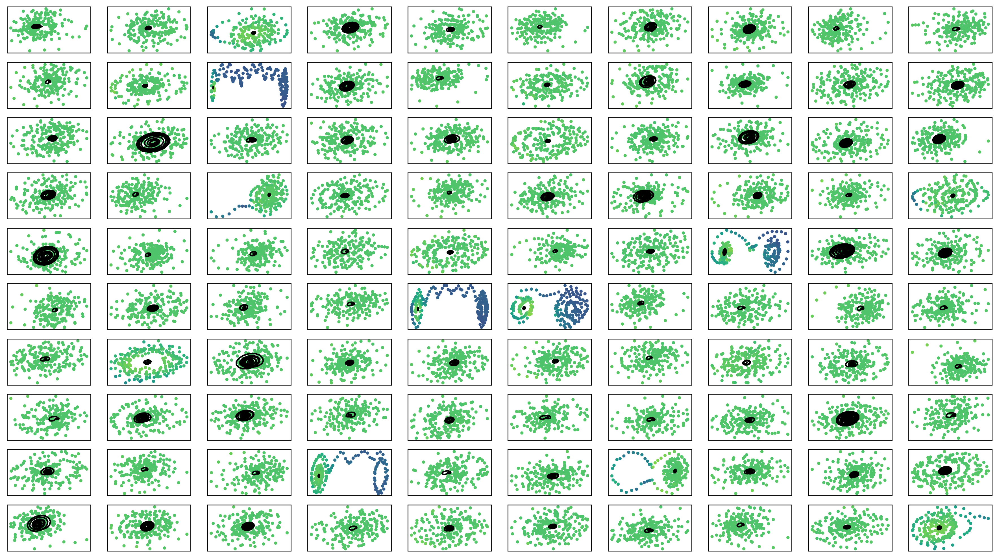

In [36]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [37]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -1103.19382  validloss -1003.65311±0.00000  bestvalidloss -1003.65311  last_update 0
train: iter 1  trainloss -1122.59912  validloss -1043.68014±0.00000  bestvalidloss -1043.68014  last_update 0
train: iter 2  trainloss -1106.35992  validloss -1019.93695±0.00000  bestvalidloss -1043.68014  last_update 1
train: iter 3  trainloss -1111.33767  validloss -950.69299±0.00000  bestvalidloss -1043.68014  last_update 2
train: iter 4  trainloss -1119.36249  validloss -1014.04986±0.00000  bestvalidloss -1043.68014  last_update 3
train: iter 5  trainloss -1123.15783  validloss -962.07806±0.00000  bestvalidloss -1043.68014  last_update 4
train: iter 6  trainloss -1110.98284  validloss -1033.44523±0.00000  bestvalidloss -1043.68014  last_update 5
train: iter 7  trainloss -1120.86403  validloss -997.57006±0.00000  bestvalidloss -1043.68014  last_update 6
train: iter 8  trainloss -1126.20410  validloss -1011.02605±0.00000  bestvalid

train: iter 74  trainloss -1083.99934  validloss -995.55403±0.00000  bestvalidloss -1065.69032  last_update 10
train: iter 75  trainloss -1117.43690  validloss -1021.97753±0.00000  bestvalidloss -1065.69032  last_update 11
train: iter 76  trainloss -1118.33529  validloss -1039.55059±0.00000  bestvalidloss -1065.69032  last_update 12
train: iter 77  trainloss -1128.57593  validloss -1045.25568±0.00000  bestvalidloss -1065.69032  last_update 13
train: iter 78  trainloss -1128.00358  validloss -1011.70858±0.00000  bestvalidloss -1065.69032  last_update 14
train: iter 79  trainloss -1131.20677  validloss -1052.02317±0.00000  bestvalidloss -1065.69032  last_update 15
train: iter 80  trainloss -1088.06085  validloss -1017.53609±0.00000  bestvalidloss -1065.69032  last_update 16
train: iter 81  trainloss -1093.95651  validloss -973.55642±0.00000  bestvalidloss -1065.69032  last_update 17
train: iter 82  trainloss -1036.99473  validloss -1007.38436±0.00000  bestvalidloss -1065.69032  last_upda

train: iter 147  trainloss -1132.39349  validloss -1057.79483±0.00000  bestvalidloss -1066.12654  last_update 47
train: iter 148  trainloss -1127.64865  validloss -1027.96452±0.00000  bestvalidloss -1066.12654  last_update 48
train: iter 149  trainloss -1125.10006  validloss -1016.42135±0.00000  bestvalidloss -1066.12654  last_update 49
train: iter 150  trainloss -1128.43674  validloss -1037.19114±0.00000  bestvalidloss -1066.12654  last_update 50
train: iter 151  trainloss -1122.62008  validloss -992.18714±0.00000  bestvalidloss -1066.12654  last_update 51
train: iter 152  trainloss -1130.21096  validloss -1058.17478±0.00000  bestvalidloss -1066.12654  last_update 52
train: iter 153  trainloss -1126.46402  validloss -1024.95197±0.00000  bestvalidloss -1066.12654  last_update 53
train: iter 154  trainloss -1124.01238  validloss -1010.72086±0.00000  bestvalidloss -1066.12654  last_update 54
train: iter 155  trainloss -1107.35668  validloss -1033.44498±0.00000  bestvalidloss -1066.12654 

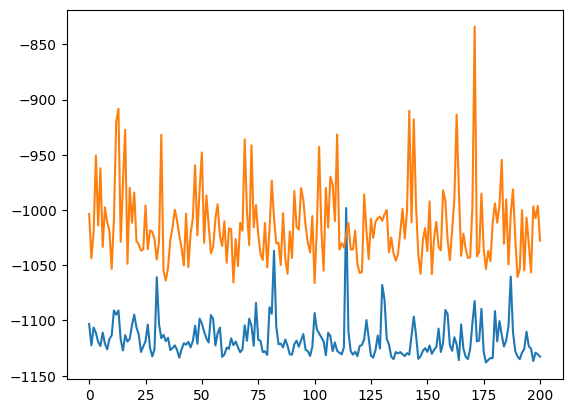

alpha 0.1 default_lr 0.0005


In [38]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

In [39]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)



実環境方策rollout vs Sim環境方策rollout


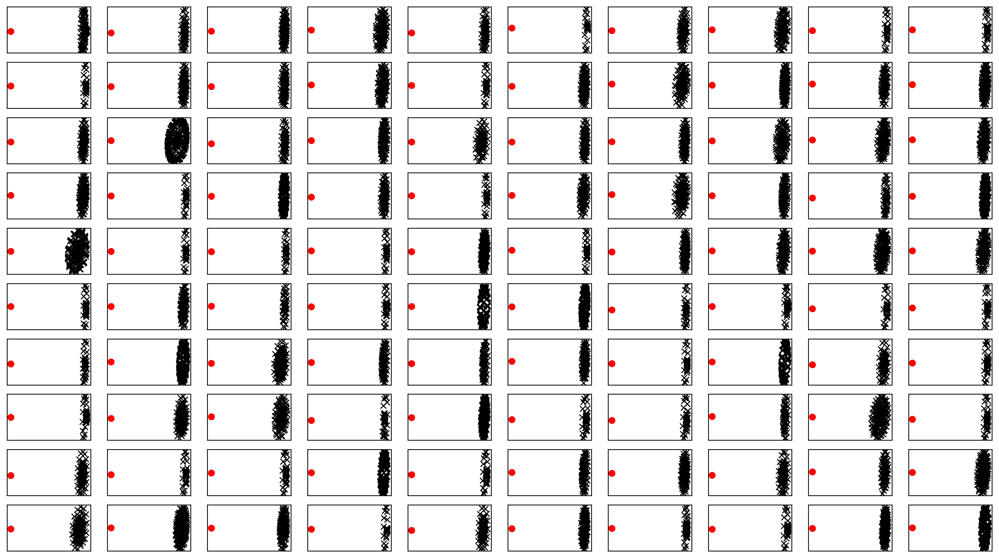

In [40]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

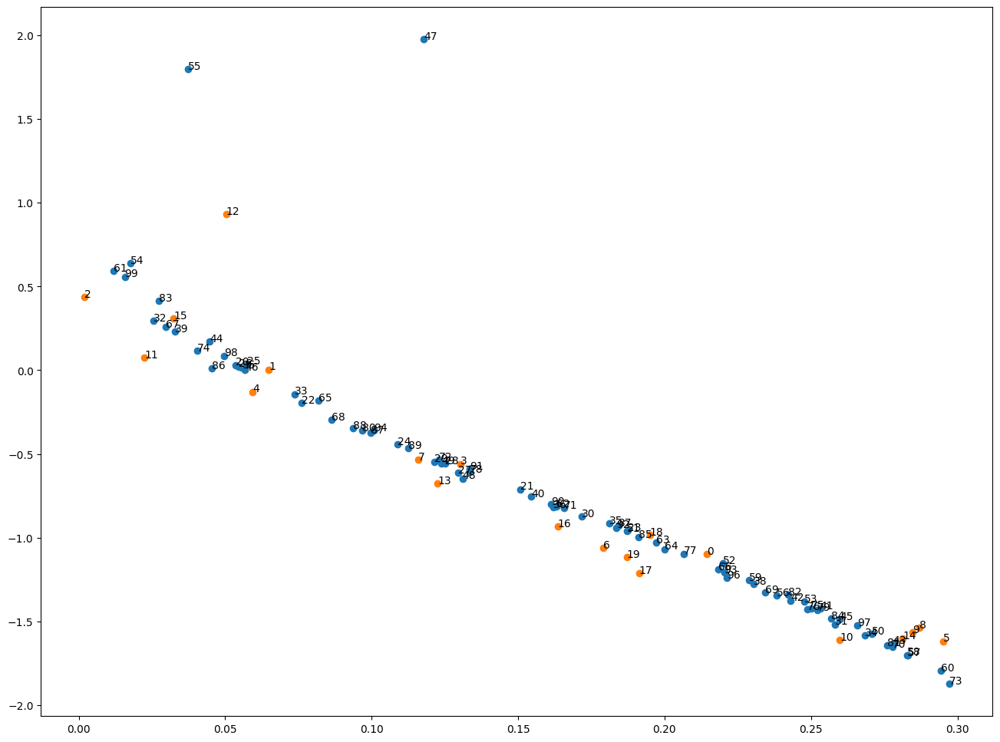

[0.2144448  0.06482685 0.00186908 0.13043746 0.05930552 0.2950202
 0.17920018 0.11597138 0.28699589 0.28469319]
[0.25988679 0.02248458 0.05039166 0.12253316 0.28127148 0.03245801
 0.1635608  0.19128307 0.19494153 0.18717483]
[0.05369217 0.15075992 0.07610389 0.18747925 0.10885608 0.05743392
 0.05473362 0.12954662 0.12503289 0.12144757]
[0.17164163 0.25830429 0.02539848 0.07363611 0.26839539 0.18106905
 0.16202242 0.18436885 0.23032741 0.03294544]
[0.15439611 0.2531121  0.24304333 0.27801621 0.04461805 0.25973247
 0.05670773 0.11783435 0.13102989 0.12374166]
[0.27072656 0.18707065 0.21989962 0.24780686 0.01766403 0.03720439
 0.238327   0.28313925 0.28277575 0.22889809]
[0.29436298 0.01202734 0.16298709 0.19724539 0.19996752 0.08174144
 0.21848083 0.02979833 0.08641105 0.23445934]
[0.27774258 0.16557793 0.12287742 0.29723905 0.04042578 0.25013441
 0.24882538 0.20646638 0.1333622  0.25213982]
[0.09677249 0.2759962  0.24226469 0.02727317 0.25685513 0.1910546
 0.04556568 0.09974855 0.093661

In [41]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [42]:
print(datetime.datetime.now())

2023-06-12 15:39:55.976269


# Iter 4

In [43]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [44]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.33335  validloss 1.36878±0.00000  bestvalidloss 1.36878  last_update 0
train: iter 1  trainloss 1.32876  validloss 1.35936±0.00000  bestvalidloss 1.35936  last_update 0
train: iter 2  trainloss 1.33004  validloss 1.36148±0.00000  bestvalidloss 1.35936  last_update 1
train: iter 3  trainloss 1.32993  validloss 1.34902±0.00000  bestvalidloss 1.34902  last_update 0
train: iter 4  trainloss 1.32767  validloss 1.35587±0.00000  bestvalidloss 1.34902  last_update 1
train: iter 5  trainloss 1.32830  validloss 1.35459±0.00000  bestvalidloss 1.34902  last_update 2
train: iter 6  trainloss 1.32966  validloss 1.35862±0.00000  bestvalidloss 1.34902  last_update 3
train: iter 7  trainloss 1.32857  validloss 1.37209±0.00000  bestvalidloss 1.34902  last_update 4
train: iter 8  trainloss 1.32818  validloss 1.35323±0.00000  bestvalidloss 1.34902  last_update 5
train: iter 9  trainloss 1.32763  validloss 1.37679±0.00000  bestvalidloss 1.34902  last_update 6
train: iter 10  trai

train: iter 83  trainloss 1.32259  validloss 1.35714±0.00000  bestvalidloss 1.34545  last_update 51
train: iter 84  trainloss 1.32253  validloss 1.37156±0.00000  bestvalidloss 1.34545  last_update 52
train: iter 85  trainloss 1.32466  validloss 1.35204±0.00000  bestvalidloss 1.34545  last_update 53
train: iter 86  trainloss 1.32468  validloss 1.35143±0.00000  bestvalidloss 1.34545  last_update 54
train: iter 87  trainloss 1.32557  validloss 1.35854±0.00000  bestvalidloss 1.34545  last_update 55
train: iter 88  trainloss 1.32264  validloss 1.35305±0.00000  bestvalidloss 1.34545  last_update 56
train: iter 89  trainloss 1.32507  validloss 1.36853±0.00000  bestvalidloss 1.34545  last_update 57
train: iter 90  trainloss 1.32217  validloss 1.34961±0.00000  bestvalidloss 1.34545  last_update 58
train: iter 91  trainloss 1.32559  validloss 1.37490±0.00000  bestvalidloss 1.34545  last_update 59
train: iter 92  trainloss 1.32323  validloss 1.35098±0.00000  bestvalidloss 1.34545  last_update 60


([1.333348497003317,
  1.3287645690143108,
  1.3300372995436192,
  1.3299312401562928,
  1.3276675567030907,
  1.3282992493361234,
  1.329657531902194,
  1.328572904318571,
  1.3281765647232533,
  1.3276308208703995,
  1.327385552227497,
  1.3281253170222045,
  1.3266762230545281,
  1.3293970093131064,
  1.3281752794981003,
  1.3262899078428745,
  1.3285564050078391,
  1.3263842780143023,
  1.3272256586700677,
  1.3309556361287833,
  1.3268751613795757,
  1.3262909520417452,
  1.3267405148595572,
  1.3270667143166066,
  1.3277017634361983,
  1.3266193326562643,
  1.3260875839740038,
  1.3278079729527235,
  1.3264850065112115,
  1.3264325574040412,
  1.3252195086330176,
  1.3289947751909494,
  1.3268456347286701,
  1.3259787138551473,
  1.3256979029625655,
  1.3256118047982455,
  1.3255011111497879,
  1.3264859087765217,
  1.3264580447226764,
  1.3285529967397451,
  1.3243717420846224,
  1.3255814895033837,
  1.3243301253765822,
  1.324607977643609,
  1.3237694825977087,
  1.32583016753

In [45]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -5.815621050453185
valid_loss:  -5.325322501945495
weight_alpha 1.0 h_min_tilde -6.1621222 ell_tilde -5.717561340751647 kappa_tilde 0.0014998035049299428
train_loss:  -5.64572771434784
valid_loss:  -5.0022254337310805
weight_alpha 0.1 h_min_tilde -6.1621222 ell_tilde -5.517027258224489 kappa_tilde 0.0012450539344071154


1e-08 1000.0


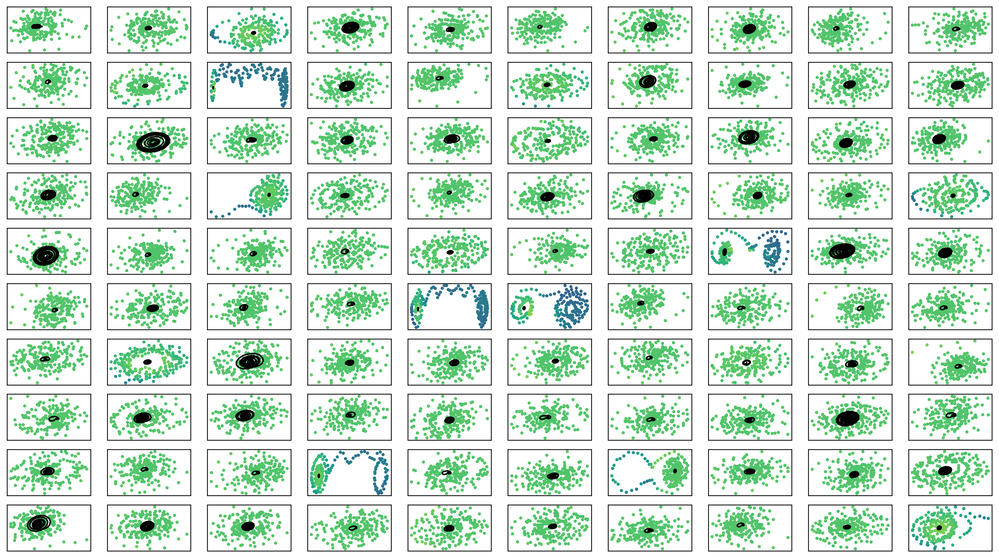

In [46]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [47]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -1106.27897  validloss -1002.97186±0.00000  bestvalidloss -1002.97186  last_update 0
train: iter 1  trainloss -1133.86781  validloss -1013.22522±0.00000  bestvalidloss -1013.22522  last_update 0
train: iter 2  trainloss -1122.02780  validloss -996.07283±0.00000  bestvalidloss -1013.22522  last_update 1
train: iter 3  trainloss -1135.33517  validloss -1004.85422±0.00000  bestvalidloss -1013.22522  last_update 2
train: iter 4  trainloss -1133.38332  validloss -1020.47814±0.00000  bestvalidloss -1020.47814  last_update 0
train: iter 5  trainloss -1126.33859  validloss -1009.24207±0.00000  bestvalidloss -1020.47814  last_update 1
train: iter 6  trainloss -1113.88201  validloss -1014.49590±0.00000  bestvalidloss -1020.47814  last_update 2
train: iter 7  trainloss -1105.04209  validloss -1042.38599±0.00000  bestvalidloss -1042.38599  last_update 0
train: iter 8  trainloss -1125.80947  validloss -976.09090±0.00000  bestvali

train: iter 74  trainloss -1140.63807  validloss -1050.86135±0.00000  bestvalidloss -1072.67344  last_update 15
train: iter 75  trainloss -1133.50990  validloss -1044.61111±0.00000  bestvalidloss -1072.67344  last_update 16
train: iter 76  trainloss -1091.28419  validloss -1044.52212±0.00000  bestvalidloss -1072.67344  last_update 17
train: iter 77  trainloss -1131.71403  validloss -1036.29336±0.00000  bestvalidloss -1072.67344  last_update 18
train: iter 78  trainloss -1132.72942  validloss -1055.05462±0.00000  bestvalidloss -1072.67344  last_update 19
train: iter 79  trainloss -1131.85679  validloss -1056.97111±0.00000  bestvalidloss -1072.67344  last_update 20
train: iter 80  trainloss -1129.91886  validloss -1018.38685±0.00000  bestvalidloss -1072.67344  last_update 21
train: iter 81  trainloss -1137.72622  validloss -1057.13688±0.00000  bestvalidloss -1072.67344  last_update 22
train: iter 82  trainloss -1127.05501  validloss -1037.12190±0.00000  bestvalidloss -1072.67344  last_up

train: iter 147  trainloss -1109.29826  validloss -1029.80652±0.00000  bestvalidloss -1072.67344  last_update 88
train: iter 148  trainloss -1126.40288  validloss -1029.49647±0.00000  bestvalidloss -1072.67344  last_update 89
train: iter 149  trainloss -1138.79352  validloss -1047.29061±0.00000  bestvalidloss -1072.67344  last_update 90
train: iter 150  trainloss -1133.72766  validloss -1035.90541±0.00000  bestvalidloss -1072.67344  last_update 91
train: iter 151  trainloss -1135.20527  validloss -951.24876±0.00000  bestvalidloss -1072.67344  last_update 92
train: iter 152  trainloss -1138.11956  validloss -1033.04472±0.00000  bestvalidloss -1072.67344  last_update 93
train: iter 153  trainloss -1133.13513  validloss -999.51873±0.00000  bestvalidloss -1072.67344  last_update 94
train: iter 154  trainloss -1134.24852  validloss -1041.78362±0.00000  bestvalidloss -1072.67344  last_update 95
train: iter 155  trainloss -1126.94829  validloss -933.04608±0.00000  bestvalidloss -1072.67344  l

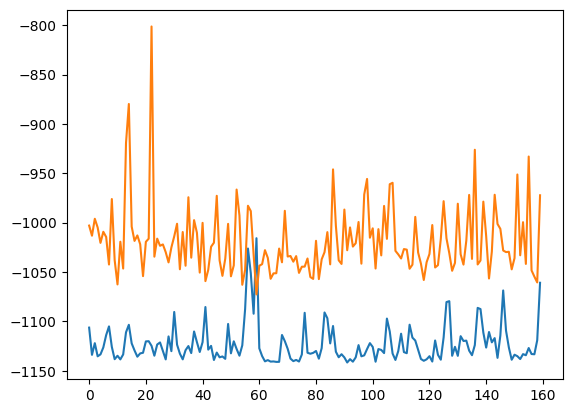

alpha 0.1 default_lr 0.0005


In [48]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

実環境方策rollout vs Sim環境方策rollout


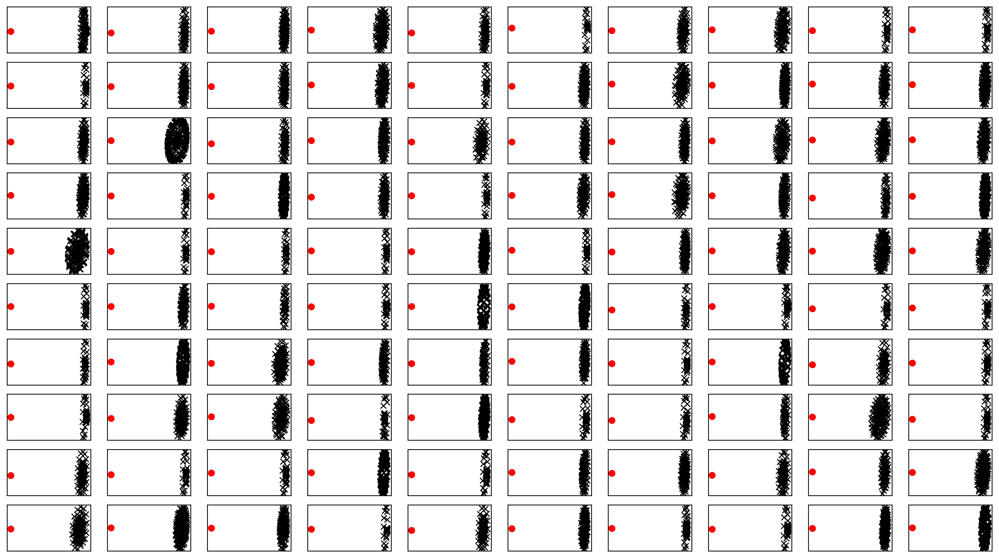

In [49]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

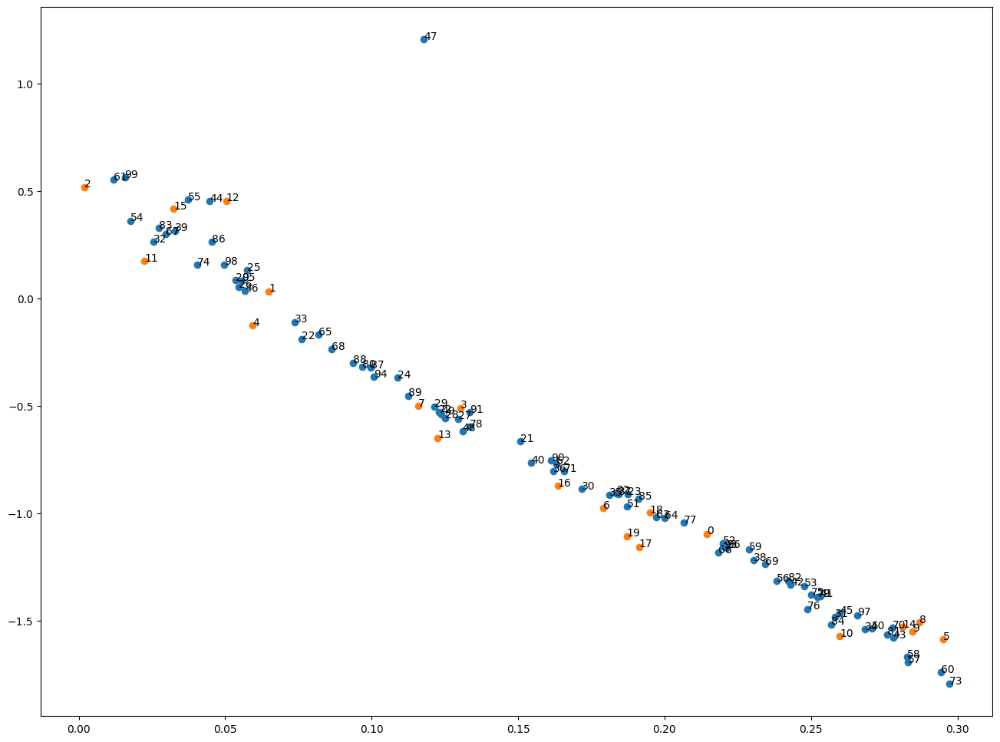

[0.2144448  0.06482685 0.00186908 0.13043746 0.05930552 0.2950202
 0.17920018 0.11597138 0.28699589 0.28469319]
[0.25988679 0.02248458 0.05039166 0.12253316 0.28127148 0.03245801
 0.1635608  0.19128307 0.19494153 0.18717483]
[0.05369217 0.15075992 0.07610389 0.18747925 0.10885608 0.05743392
 0.05473362 0.12954662 0.12503289 0.12144757]
[0.17164163 0.25830429 0.02539848 0.07363611 0.26839539 0.18106905
 0.16202242 0.18436885 0.23032741 0.03294544]
[0.15439611 0.2531121  0.24304333 0.27801621 0.04461805 0.25973247
 0.05670773 0.11783435 0.13102989 0.12374166]
[0.27072656 0.18707065 0.21989962 0.24780686 0.01766403 0.03720439
 0.238327   0.28313925 0.28277575 0.22889809]
[0.29436298 0.01202734 0.16298709 0.19724539 0.19996752 0.08174144
 0.21848083 0.02979833 0.08641105 0.23445934]
[0.27774258 0.16557793 0.12287742 0.29723905 0.04042578 0.25013441
 0.24882538 0.20646638 0.1333622  0.25213982]
[0.09677249 0.2759962  0.24226469 0.02727317 0.25685513 0.1910546
 0.04556568 0.09974855 0.093661

In [50]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [51]:
print(datetime.datetime.now())

2023-06-12 15:58:29.825840


# Iter 5

In [52]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [53]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.33354  validloss 1.36848±0.00000  bestvalidloss 1.36848  last_update 0
train: iter 1  trainloss 1.33200  validloss 1.36462±0.00000  bestvalidloss 1.36462  last_update 0
train: iter 2  trainloss 1.33122  validloss 1.36880±0.00000  bestvalidloss 1.36462  last_update 1
train: iter 3  trainloss 1.33048  validloss 1.36520±0.00000  bestvalidloss 1.36462  last_update 2
train: iter 4  trainloss 1.33091  validloss 1.37460±0.00000  bestvalidloss 1.36462  last_update 3
train: iter 5  trainloss 1.32975  validloss 1.37027±0.00000  bestvalidloss 1.36462  last_update 4
train: iter 6  trainloss 1.32975  validloss 1.36448±0.00000  bestvalidloss 1.36448  last_update 0
train: iter 7  trainloss 1.32997  validloss 1.36413±0.00000  bestvalidloss 1.36413  last_update 0
train: iter 8  trainloss 1.32872  validloss 1.36746±0.00000  bestvalidloss 1.36413  last_update 1
train: iter 9  trainloss 1.32840  validloss 1.37613±0.00000  bestvalidloss 1.36413  last_update 2
train: iter 10  trai

train: iter 83  trainloss 1.32207  validloss 1.40140±0.00000  bestvalidloss 1.35933  last_update 67
train: iter 84  trainloss 1.32094  validloss 1.38060±0.00000  bestvalidloss 1.35933  last_update 68
train: iter 85  trainloss 1.32233  validloss 1.38677±0.00000  bestvalidloss 1.35933  last_update 69
train: iter 86  trainloss 1.32344  validloss 1.37752±0.00000  bestvalidloss 1.35933  last_update 70
train: iter 87  trainloss 1.32406  validloss 1.40766±0.00000  bestvalidloss 1.35933  last_update 71
train: iter 88  trainloss 1.32148  validloss 1.39283±0.00000  bestvalidloss 1.35933  last_update 72
train: iter 89  trainloss 1.32150  validloss 1.37620±0.00000  bestvalidloss 1.35933  last_update 73
train: iter 90  trainloss 1.32102  validloss 1.39045±0.00000  bestvalidloss 1.35933  last_update 74
train: iter 91  trainloss 1.32143  validloss 1.39698±0.00000  bestvalidloss 1.35933  last_update 75
train: iter 92  trainloss 1.32132  validloss 1.39025±0.00000  bestvalidloss 1.35933  last_update 76


([1.3335364624857902,
  1.331995962560177,
  1.3312229372560977,
  1.330483540892601,
  1.3309111043810844,
  1.3297484792768954,
  1.3297477953135968,
  1.3299655579030514,
  1.3287218190729617,
  1.328404924273491,
  1.3284812480211259,
  1.3275879971683024,
  1.329871229827404,
  1.326903822273016,
  1.3271131463348866,
  1.3263328611850738,
  1.3272859200835228,
  1.326255214214325,
  1.3277719378471375,
  1.3251781351864338,
  1.325108852237463,
  1.326217208057642,
  1.326540944725275,
  1.3244234293699264,
  1.3246663428843022,
  1.3276028715074062,
  1.3258188225328922,
  1.3252292588353156,
  1.3269360922276974,
  1.3240072920918464,
  1.3254777133464812,
  1.3245586559176445,
  1.3260760307312012,
  1.324021080136299,
  1.3259286418557168,
  1.323602643609047,
  1.324490337073803,
  1.3248371653258801,
  1.325885621458292,
  1.323700549453497,
  1.3241108648478985,
  1.3245606318116188,
  1.3235230460762977,
  1.3230730064213276,
  1.322944239526987,
  1.3253236040472984,
  1

In [54]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -5.935143531084061
valid_loss:  -5.722306243133545
weight_alpha 1.0 h_min_tilde -6.1621165 ell_tilde -5.8925760734939585 kappa_tilde 0.0019261407623316115
train_loss:  -5.4800269039809715
valid_loss:  -4.920648130607605
weight_alpha 0.1 h_min_tilde -6.1621165 ell_tilde -5.368151149306297 kappa_tilde 0.0011222748163325722


1e-08 1000.0


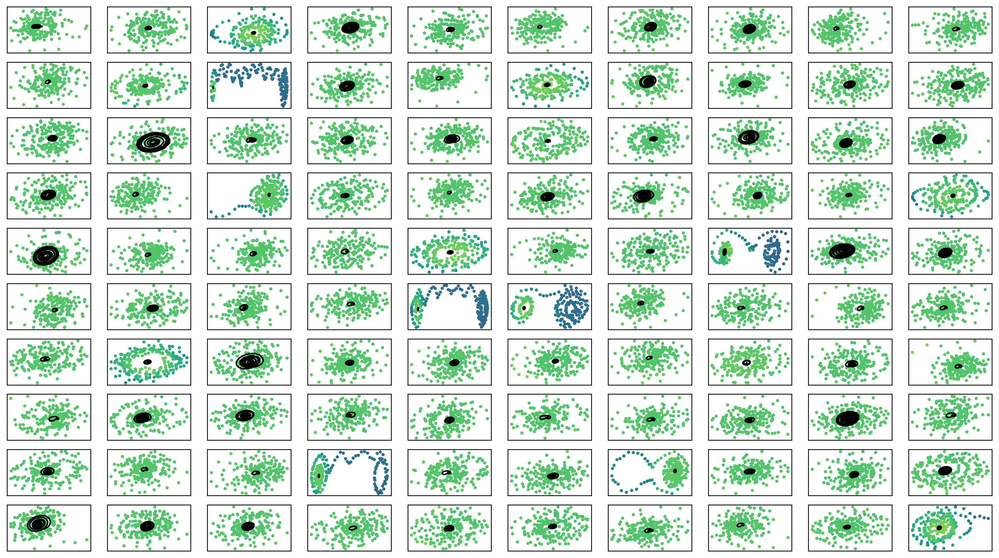

In [55]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [56]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -1112.50490  validloss -980.70428±0.00000  bestvalidloss -980.70428  last_update 0
train: iter 1  trainloss -1125.50710  validloss -1065.37840±0.00000  bestvalidloss -1065.37840  last_update 0
train: iter 2  trainloss -1102.68757  validloss -924.60517±0.00000  bestvalidloss -1065.37840  last_update 1
train: iter 3  trainloss -1118.08087  validloss -939.45380±0.00000  bestvalidloss -1065.37840  last_update 2
train: iter 4  trainloss -1137.76412  validloss -958.78896±0.00000  bestvalidloss -1065.37840  last_update 3
train: iter 5  trainloss -1140.61752  validloss -1051.31067±0.00000  bestvalidloss -1065.37840  last_update 4
train: iter 6  trainloss -1135.50783  validloss -1033.47638±0.00000  bestvalidloss -1065.37840  last_update 5
train: iter 7  trainloss -1121.95467  validloss -996.73993±0.00000  bestvalidloss -1065.37840  last_update 6
train: iter 8  trainloss -1121.02455  validloss -1042.66307±0.00000  bestvalidlos

train: iter 75  trainloss -1112.77584  validloss -1035.84100±0.00000  bestvalidloss -1068.44168  last_update 64
train: iter 76  trainloss -1124.52382  validloss -913.62304±0.00000  bestvalidloss -1068.44168  last_update 65
train: iter 77  trainloss -1140.81443  validloss -1061.60836±0.00000  bestvalidloss -1068.44168  last_update 66
train: iter 78  trainloss -1127.52704  validloss -1058.72647±0.00000  bestvalidloss -1068.44168  last_update 67
train: iter 79  trainloss -1146.46803  validloss -1043.19978±0.00000  bestvalidloss -1068.44168  last_update 68
train: iter 80  trainloss -1137.51632  validloss -1071.01712±0.00000  bestvalidloss -1071.01712  last_update 0
train: iter 81  trainloss -1127.29875  validloss -1047.92585±0.00000  bestvalidloss -1071.01712  last_update 1
train: iter 82  trainloss -1141.79489  validloss -1049.51858±0.00000  bestvalidloss -1071.01712  last_update 2
train: iter 83  trainloss -1145.68256  validloss -1070.69050±0.00000  bestvalidloss -1071.01712  last_update

train: iter 148  trainloss -1140.45599  validloss -1019.91473±0.00000  bestvalidloss -1071.01712  last_update 68
train: iter 149  trainloss -1148.37305  validloss -1057.15966±0.00000  bestvalidloss -1071.01712  last_update 69
train: iter 150  trainloss -1136.77801  validloss -1020.46810±0.00000  bestvalidloss -1071.01712  last_update 70
train: iter 151  trainloss -1124.97530  validloss -1044.26975±0.00000  bestvalidloss -1071.01712  last_update 71
train: iter 152  trainloss -1137.22600  validloss -1040.66273±0.00000  bestvalidloss -1071.01712  last_update 72
train: iter 153  trainloss -1132.80805  validloss -1052.71195±0.00000  bestvalidloss -1071.01712  last_update 73
train: iter 154  trainloss -1116.10853  validloss -1054.83065±0.00000  bestvalidloss -1071.01712  last_update 74
train: iter 155  trainloss -1143.81981  validloss -1014.77959±0.00000  bestvalidloss -1071.01712  last_update 75
train: iter 156  trainloss -1138.76270  validloss -1013.24451±0.00000  bestvalidloss -1071.01712

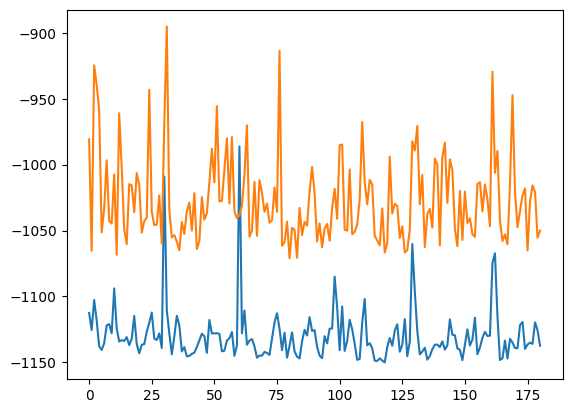

alpha 0.1 default_lr 0.0005


In [57]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

実環境方策rollout vs Sim環境方策rollout


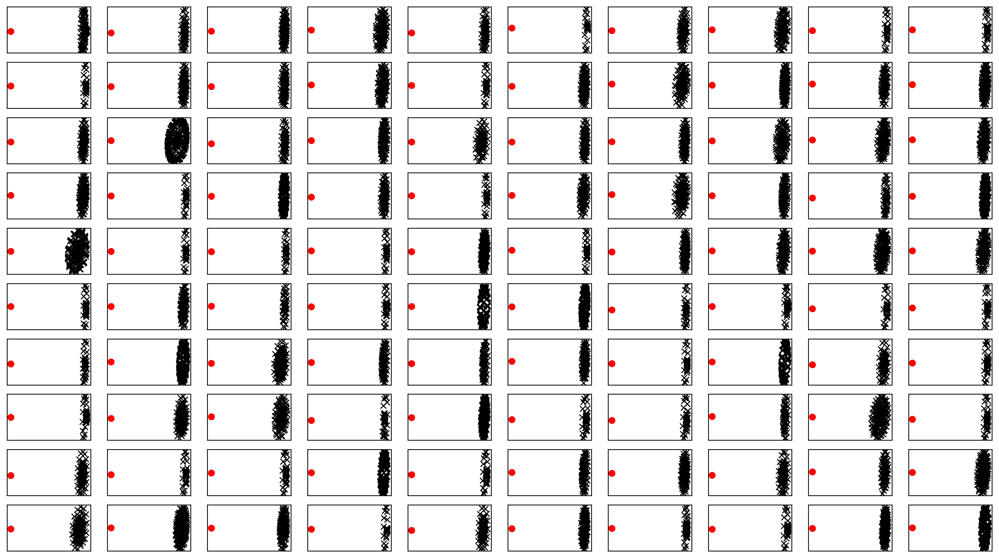

In [58]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

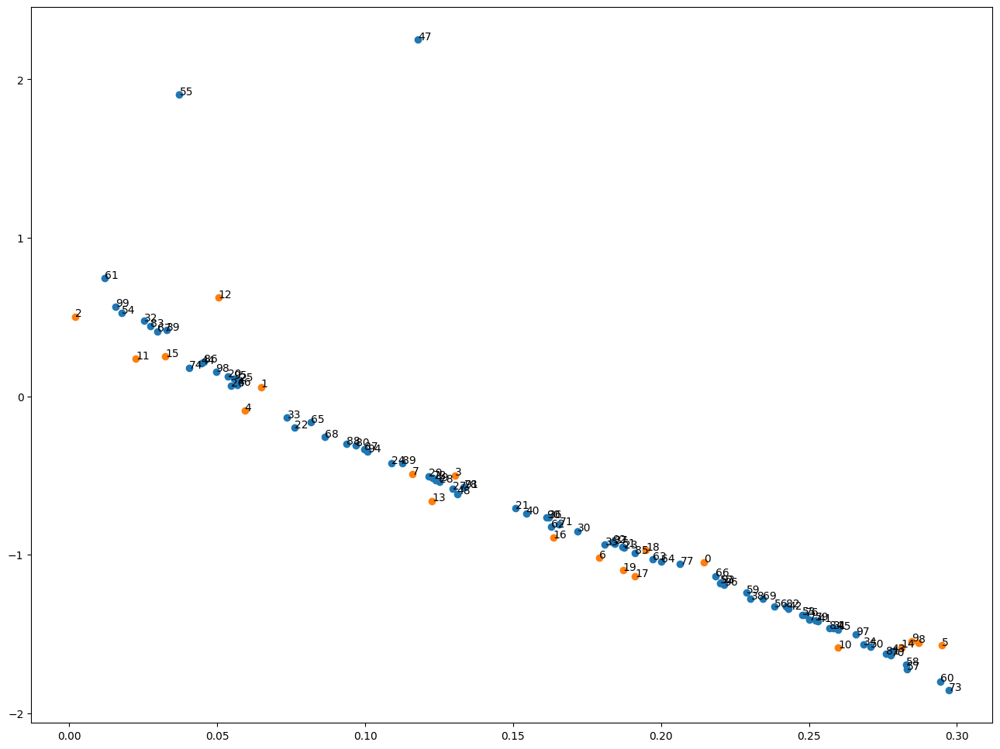

[0.2144448  0.06482685 0.00186908 0.13043746 0.05930552 0.2950202
 0.17920018 0.11597138 0.28699589 0.28469319]
[0.25988679 0.02248458 0.05039166 0.12253316 0.28127148 0.03245801
 0.1635608  0.19128307 0.19494153 0.18717483]
[0.05369217 0.15075992 0.07610389 0.18747925 0.10885608 0.05743392
 0.05473362 0.12954662 0.12503289 0.12144757]
[0.17164163 0.25830429 0.02539848 0.07363611 0.26839539 0.18106905
 0.16202242 0.18436885 0.23032741 0.03294544]
[0.15439611 0.2531121  0.24304333 0.27801621 0.04461805 0.25973247
 0.05670773 0.11783435 0.13102989 0.12374166]
[0.27072656 0.18707065 0.21989962 0.24780686 0.01766403 0.03720439
 0.238327   0.28313925 0.28277575 0.22889809]
[0.29436298 0.01202734 0.16298709 0.19724539 0.19996752 0.08174144
 0.21848083 0.02979833 0.08641105 0.23445934]
[0.27774258 0.16557793 0.12287742 0.29723905 0.04042578 0.25013441
 0.24882538 0.20646638 0.1333622  0.25213982]
[0.09677249 0.2759962  0.24226469 0.02727317 0.25685513 0.1910546
 0.04556568 0.09974855 0.093661

In [59]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# 評価関数計算

In [60]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [61]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.33176  validloss 1.39322±0.00000  bestvalidloss 1.39322  last_update 0
train: iter 1  trainloss 1.32532  validloss 1.36768±0.00000  bestvalidloss 1.36768  last_update 0
train: iter 2  trainloss 1.32364  validloss 1.37771±0.00000  bestvalidloss 1.36768  last_update 1
train: iter 3  trainloss 1.32210  validloss 1.35862±0.00000  bestvalidloss 1.35862  last_update 0
train: iter 4  trainloss 1.32278  validloss 1.37514±0.00000  bestvalidloss 1.35862  last_update 1
train: iter 5  trainloss 1.32190  validloss 1.35829±0.00000  bestvalidloss 1.35829  last_update 0
train: iter 6  trainloss 1.32061  validloss 1.37592±0.00000  bestvalidloss 1.35829  last_update 1
train: iter 7  trainloss 1.32123  validloss 1.35293±0.00000  bestvalidloss 1.35293  last_update 0
train: iter 8  trainloss 1.32001  validloss 1.35282±0.00000  bestvalidloss 1.35282  last_update 0
train: iter 9  trainloss 1.32029  validloss 1.34677±0.00000  bestvalidloss 1.34677  last_update 0
train: iter 10  trai

train: iter 83  trainloss 1.31433  validloss 1.35706±0.00000  bestvalidloss 1.34677  last_update 74
train: iter 84  trainloss 1.31293  validloss 1.38574±0.00000  bestvalidloss 1.34677  last_update 75
train: iter 85  trainloss 1.31475  validloss 1.36017±0.00000  bestvalidloss 1.34677  last_update 76
train: iter 86  trainloss 1.31359  validloss 1.38302±0.00000  bestvalidloss 1.34677  last_update 77
train: iter 87  trainloss 1.31425  validloss 1.37505±0.00000  bestvalidloss 1.34677  last_update 78
train: iter 88  trainloss 1.31392  validloss 1.39389±0.00000  bestvalidloss 1.34677  last_update 79
train: iter 89  trainloss 1.31373  validloss 1.38996±0.00000  bestvalidloss 1.34677  last_update 80
train: iter 90  trainloss 1.31304  validloss 1.37671±0.00000  bestvalidloss 1.34677  last_update 81
train: iter 91  trainloss 1.31327  validloss 1.39109±0.00000  bestvalidloss 1.34677  last_update 82
train: iter 92  trainloss 1.31324  validloss 1.38656±0.00000  bestvalidloss 1.34677  last_update 83


([1.3317563116550446,
  1.3253213450312615,
  1.3236406028270722,
  1.3221045337617396,
  1.3227839387953282,
  1.3218982972204685,
  1.320609275996685,
  1.3212288059294224,
  1.3200118638575078,
  1.3202949661761523,
  1.3196793749928475,
  1.3197601340711116,
  1.3196159593760968,
  1.3207951031625271,
  1.321640557050705,
  1.3197351008653642,
  1.3188604243099689,
  1.318458230048418,
  1.3196014627814292,
  1.3209216915071011,
  1.317746139317751,
  1.319763618707657,
  1.317631058767438,
  1.3189214445650577,
  1.31840835288167,
  1.3171236637979746,
  1.3172929219901561,
  1.3170311022549868,
  1.318290150165558,
  1.3166766367852687,
  1.3177252668887376,
  1.3183892376720905,
  1.3166542712599039,
  1.3176202427595853,
  1.3168011642992496,
  1.3170295890420676,
  1.3163648225367068,
  1.3173641085624694,
  1.3169174544513225,
  1.3161395125091075,
  1.3187292754650115,
  1.3159293077886105,
  1.3166715290397406,
  1.3175751477479936,
  1.3159227557480335,
  1.316006061434745

In [62]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -5.964099262332917
valid_loss:  -5.673853709411621
weight_alpha 1.0 h_min_tilde -6.162121 ell_tilde -5.906050151748658 kappa_tilde 0.0019761508038338934
train_loss:  -5.720009640264511
valid_loss:  -5.255725901985168
weight_alpha 0.1 h_min_tilde -6.162121 ell_tilde -5.627152892608642 kappa_tilde 0.0013672128372093388


1e-08 1000.0


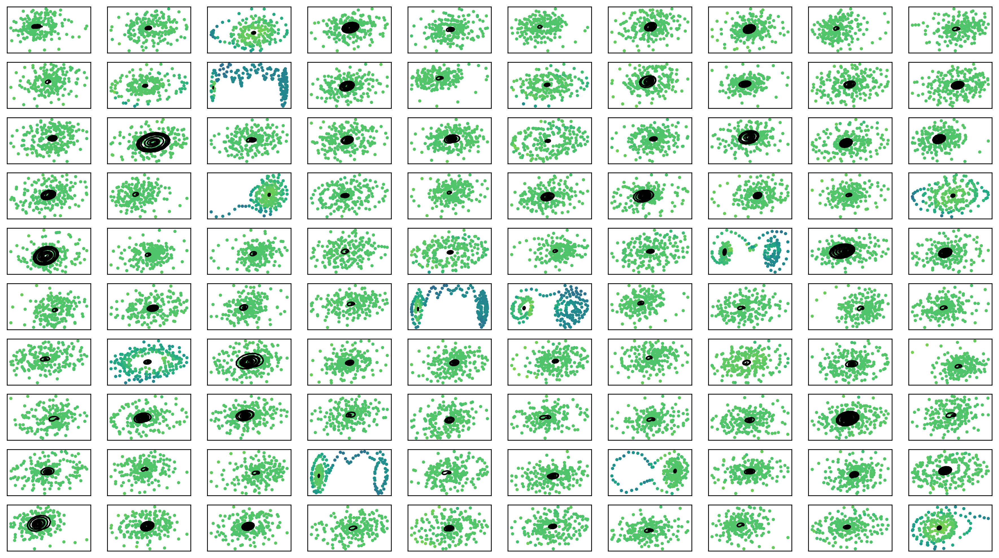

In [63]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter6.png")

In [64]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=default_early)


train: iter 0  trainloss 1.55476  validloss 1.36430±0.00000  bestvalidloss 1.36430  last_update 0
train: iter 1  trainloss 1.50414  validloss 1.31840±0.00000  bestvalidloss 1.31840  last_update 0
train: iter 2  trainloss 1.46771  validloss 1.30883±0.00000  bestvalidloss 1.30883  last_update 0
train: iter 3  trainloss 1.42672  validloss 1.25347±0.00000  bestvalidloss 1.25347  last_update 0
train: iter 4  trainloss 1.40469  validloss 1.22801±0.00000  bestvalidloss 1.22801  last_update 0
train: iter 5  trainloss 1.37602  validloss 1.19400±0.00000  bestvalidloss 1.19400  last_update 0
train: iter 6  trainloss 1.36944  validloss 1.18759±0.00000  bestvalidloss 1.18759  last_update 0
train: iter 7  trainloss 1.33195  validloss 1.16819±0.00000  bestvalidloss 1.16819  last_update 0
train: iter 8  trainloss 1.31750  validloss 1.15455±0.00000  bestvalidloss 1.15455  last_update 0
train: iter 9  trainloss 1.29879  validloss 1.15114±0.00000  bestvalidloss 1.15114  last_update 0
train: iter 10  trai

train: iter 96  trainloss 1.19718  validloss 1.10429±0.00000  bestvalidloss 1.08367  last_update 63
train: iter 97  trainloss 1.19941  validloss 1.10532±0.00000  bestvalidloss 1.08367  last_update 64
train: iter 98  trainloss 1.19667  validloss 1.09834±0.00000  bestvalidloss 1.08367  last_update 65
train: iter 99  trainloss 1.19713  validloss 1.10553±0.00000  bestvalidloss 1.08367  last_update 66
train: iter 100  trainloss 1.19597  validloss 1.10199±0.00000  bestvalidloss 1.08367  last_update 67
train: iter 101  trainloss 1.19739  validloss 1.10863±0.00000  bestvalidloss 1.08367  last_update 68
train: iter 102  trainloss 1.20172  validloss 1.09976±0.00000  bestvalidloss 1.08367  last_update 69
train: iter 103  trainloss 1.19884  validloss 1.10894±0.00000  bestvalidloss 1.08367  last_update 70
train: iter 104  trainloss 1.19834  validloss 1.10428±0.00000  bestvalidloss 1.08367  last_update 71
train: iter 105  trainloss 1.19590  validloss 1.10308±0.00000  bestvalidloss 1.08367  last_upda

In [65]:
print(iwvi.initial_belief)


Parameter containing:
tensor([-0.6865, -0.6750], requires_grad=True)


In [66]:
train_curve, valid_curve = iwvi.train_penalty(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early)

train: iter 0  trainloss 4.32127  validloss 6.71455±0.00000  bestvalidloss 6.71455  last_update 0
train: iter 1  trainloss 1.68174  validloss 2.58764±0.00000  bestvalidloss 2.58764  last_update 0
train: iter 2  trainloss 1.23039  validloss 2.03951±0.00000  bestvalidloss 2.03951  last_update 0
train: iter 3  trainloss 1.12040  validloss 2.18707±0.00000  bestvalidloss 2.03951  last_update 1
train: iter 4  trainloss 1.08735  validloss 2.22442±0.00000  bestvalidloss 2.03951  last_update 2
train: iter 5  trainloss 1.07386  validloss 2.04764±0.00000  bestvalidloss 2.03951  last_update 3
train: iter 6  trainloss 1.07241  validloss 1.92694±0.00000  bestvalidloss 1.92694  last_update 0
train: iter 7  trainloss 1.05108  validloss 2.15392±0.00000  bestvalidloss 1.92694  last_update 1
train: iter 8  trainloss 1.06300  validloss 2.08130±0.00000  bestvalidloss 1.92694  last_update 2
train: iter 9  trainloss 1.05829  validloss 1.86953±0.00000  bestvalidloss 1.86953  last_update 0
train: iter 10  trai

train: iter 84  trainloss 1.04376  validloss 2.02454±0.00000  bestvalidloss 1.79327  last_update 42
train: iter 85  trainloss 1.05678  validloss 2.02753±0.00000  bestvalidloss 1.79327  last_update 43
train: iter 86  trainloss 1.03889  validloss 2.09871±0.00000  bestvalidloss 1.79327  last_update 44
train: iter 87  trainloss 1.02788  validloss 2.13353±0.00000  bestvalidloss 1.79327  last_update 45
train: iter 88  trainloss 1.03744  validloss 2.07030±0.00000  bestvalidloss 1.79327  last_update 46
train: iter 89  trainloss 1.04764  validloss 2.29794±0.00000  bestvalidloss 1.79327  last_update 47
train: iter 90  trainloss 1.04054  validloss 2.18076±0.00000  bestvalidloss 1.79327  last_update 48
train: iter 91  trainloss 1.04598  validloss 2.17570±0.00000  bestvalidloss 1.79327  last_update 49
train: iter 92  trainloss 1.04363  validloss 2.23540±0.00000  bestvalidloss 1.79327  last_update 50
train: iter 93  trainloss 1.05042  validloss 2.17741±0.00000  bestvalidloss 1.79327  last_update 51


In [67]:
iwvi.save(ckpt_key="policy_optimization_iter1")

iwvi save ckpt1, ckpt2 ckpt_iwvi_basepartpendulum_policy_optimization_iter1 ckpt_iwvi_pendulum_policy_optimization_iter1
base save ckpt ckpt_basevi_pendulum_policy_optimization_iter1
base load self.initial_belief.data.sum() tensor(-1.3615)
base load dec.state_dict()['net_phat.0.weight'].sum() tensor(2.3874)


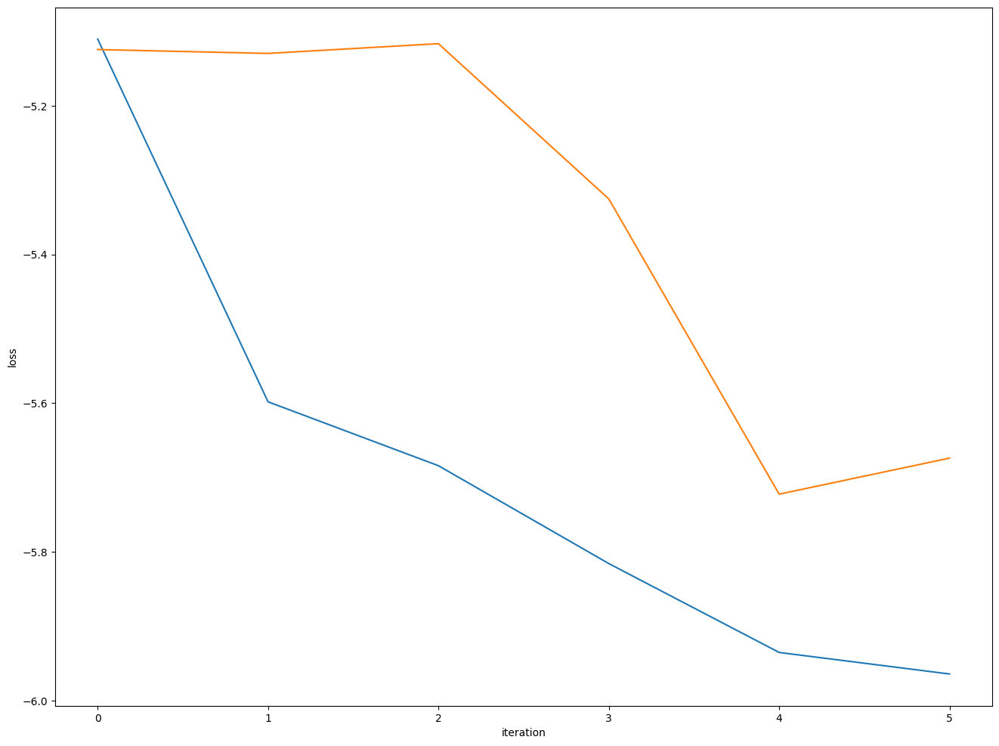

In [68]:
loss_array = np.array(loss_list)
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.plot(loss_array[:,1])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"learning_curve.png")
plt.savefig(figfilenamehead+"learning_curve.eps")
# plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

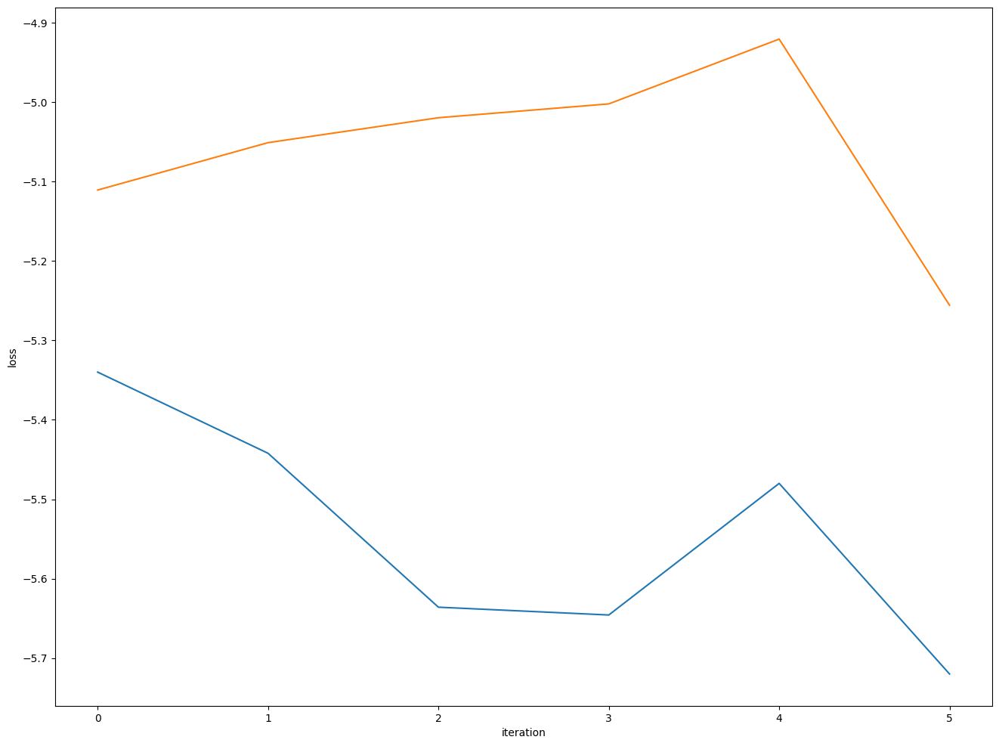

In [69]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.plot(normalized_loss_array[:,1])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"learning_curve_normalized_"+env_str+".png")
plt.savefig(figfilenamehead+"learning_curve_normalized_"+env_str+".eps")